In [ ]:
# import the necessary packages
import cv2
print(cv2.__version__)
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.inception_resnet_v2 import InceptionResNetV2
from tensorflow.keras.layers import *
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.initializers import glorot_uniform
from tensorflow.keras.utils import plot_model
from IPython.display import display
from tensorflow.keras import backend as K
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping, ModelCheckpoint, LearningRateScheduler
import os

4.10.0


In [ ]:
import os
import shutil
from collections import defaultdict

# Define the base directory of the dataset
data_dir = "A:/potato"
output_dir = "A:/tuber"  # Destination directory for the consolidated dataset

# Ensure the output directory exists
os.makedirs(output_dir, exist_ok=True)

# Define subfolder paths
original_images_dir = os.path.join(data_dir, "Original Images")
augmented_images_dir = os.path.join(data_dir, "Augmented Images")
other_classes_dir = data_dir  # For folders like Common Scab, Blackleg, etc.

# Define a mapping of consolidated class names and their corresponding folder names
consolidated_classes = {
    "Blackspot Bruising Disease": ["Blackspot Bruising Disease", "Augmented Blackspot Bruising Disease"],
    "Healthy Potato": ["Healthy Potato", "Augmented Healthy Potato", "Healthy Potatoes"],
    "Potato Brown Rot Disease": ["Potato Brown Rot Disease", "Augmented Potato Brown Rot Disease"],
    "Potato Dry Rot Disease": ["Potato Dry Rot Disease", "Augmented Potato Dry Rot Disease", "Dry Rot"],
    "Potato Soft Rot Disease": ["Potato Soft Rot Disease", "Augmented Potato Soft Rot Disease"],
    "Common Scab": ["Common Scab"],
    "Blackleg": ["Blackleg"],
    "Pink Rot": ["Pink Rot"],
    "Black Scurf": ["Black Scurf"],
}

# Function to count and move images in a folder
def process_images_in_folder(folder_path, destination_folder):
    if not os.path.exists(folder_path):
        return 0

    image_count = 0
    for root, _, files in os.walk(folder_path):
        for file in files:
            if file.endswith(".jpg") or file.endswith(".png"):
                # Ensure destination subfolder exists
                os.makedirs(destination_folder, exist_ok=True)

                # Move the file
                src_path = os.path.join(root, file)
                dest_path = os.path.join(destination_folder, file)
                shutil.move(src_path, dest_path)
                image_count += 1

    return image_count

# Initialize a dictionary to store image counts for consolidated classes
class_counts = defaultdict(int)

# Process images for each consolidated class
for class_name, folder_names in consolidated_classes.items():
    destination_folder = os.path.join(output_dir, class_name)
    for folder_name in folder_names:
        # Check in Original Images folder
        original_folder_path = os.path.join(original_images_dir, folder_name)
        class_counts[class_name] += process_images_in_folder(original_folder_path, destination_folder)

        # Check in Augmented Images folder
        augmented_folder_path = os.path.join(augmented_images_dir, folder_name)
        class_counts[class_name] += process_images_in_folder(augmented_folder_path, destination_folder)

        # Check in other classes folder (e.g., Common Scab, Blackleg)
        other_folder_path = os.path.join(other_classes_dir, folder_name)
        class_counts[class_name] += process_images_in_folder(other_folder_path, destination_folder)

# Print the consolidated class counts
print("Consolidated Class Counts:")
for class_name, count in class_counts.items():
    print(f"{class_name}: {count} images")


Consolidated Class Counts:
Blackspot Bruising Disease: 880 images
Healthy Potato: 920 images
Potato Brown Rot Disease: 120 images
Potato Dry Rot Disease: 1540 images
Potato Soft Rot Disease: 640 images
Common Scab: 61 images
Blackleg: 57 images
Pink Rot: 57 images
Black Scurf: 57 images


In [ ]:
# As "Common Scab","Blackleg","Pink Rot","Black Scurf" has less than 100 images we are removing those classs as it would effect the model accuracy.
# We are only including and merging rest of the datasets to train,val and test dataset.

In [ ]:
import os
import shutil
import random

# Define dataset paths
data_dir = "A:/tuber"
output_root = "A:/tuberSplit"
train_dir = os.path.join(output_root, "train")
val_dir = os.path.join(output_root, "val")
test_dir = os.path.join(output_root, "test")

# Define consolidated class names as subfolders
consolidated_classes = [
    "Blackspot Bruising Disease",
    "Healthy Potato",
    "Potato Brown Rot Disease",
    "Potato Dry Rot Disease",
    "Potato Soft Rot Disease",
]

# Create directories for train, val, and test
os.makedirs(train_dir, exist_ok=True)
os.makedirs(val_dir, exist_ok=True)
os.makedirs(test_dir, exist_ok=True)

# Set random seed for reproducibility
random.seed(42)

# Function to split and move/copy data
def split_and_move_data(src_folder, train_folder, val_folder, test_folder, train_ratio=0.7, val_ratio=0.15):
    files = [f for f in os.listdir(src_folder) if os.path.isfile(os.path.join(src_folder, f))]
    total_files = len(files)

    if total_files == 0:
        print(f"No files found in {src_folder}. Skipping...")
        return

    # Shuffle files
    random.shuffle(files)

    # Calculate split indices
    train_index = int(total_files * train_ratio)
    val_index = train_index + int(total_files * val_ratio)

    # Split files
    train_files = files[:train_index]
    val_files = files[train_index:val_index]
    test_files = files[val_index:]

    # Create subfolders
    subfolder_name = os.path.basename(src_folder)
    train_subfolder = os.path.join(train_folder, subfolder_name)
    val_subfolder = os.path.join(val_folder, subfolder_name)
    test_subfolder = os.path.join(test_folder, subfolder_name)

    os.makedirs(train_subfolder, exist_ok=True)
    os.makedirs(val_subfolder, exist_ok=True)
    os.makedirs(test_subfolder, exist_ok=True)

    # Copy files to avoid data loss
    for file in train_files:
        shutil.copy(os.path.join(src_folder, file), os.path.join(train_subfolder, file))
    for file in val_files:
        shutil.copy(os.path.join(src_folder, file), os.path.join(val_subfolder, file))
    for file in test_files:
        shutil.copy(os.path.join(src_folder, file), os.path.join(test_subfolder, file))

# Process each class
for class_name in consolidated_classes:
    src_folder = os.path.join(data_dir, class_name)
    if os.path.exists(src_folder):
        split_and_move_data(src_folder, train_dir, val_dir, test_dir)
    else:
        print(f"Path does not exist: {src_folder}")

print("Data successfully split into train, val, and test folders!")


Data successfully split into train, val, and test folders!


Image Counts by Class and Subset:
                            train  val  test  Total
Blackspot Bruising Disease    616  132   132    880
Healthy Potato                644  138   138    920
Potato Brown Rot Disease       84   18    18    120
Potato Dry Rot Disease       1078  231   230   1539
Potato Soft Rot Disease       448   96    96    640


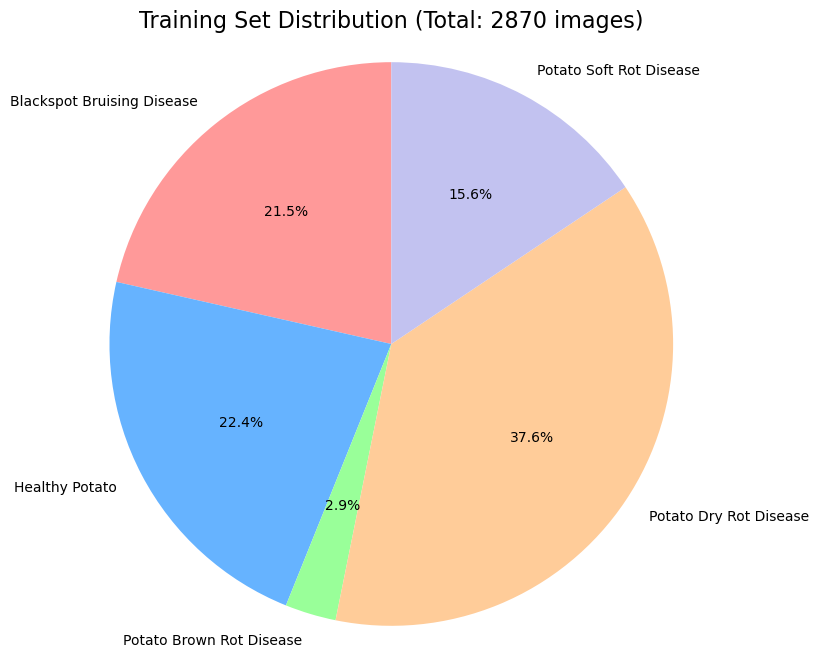

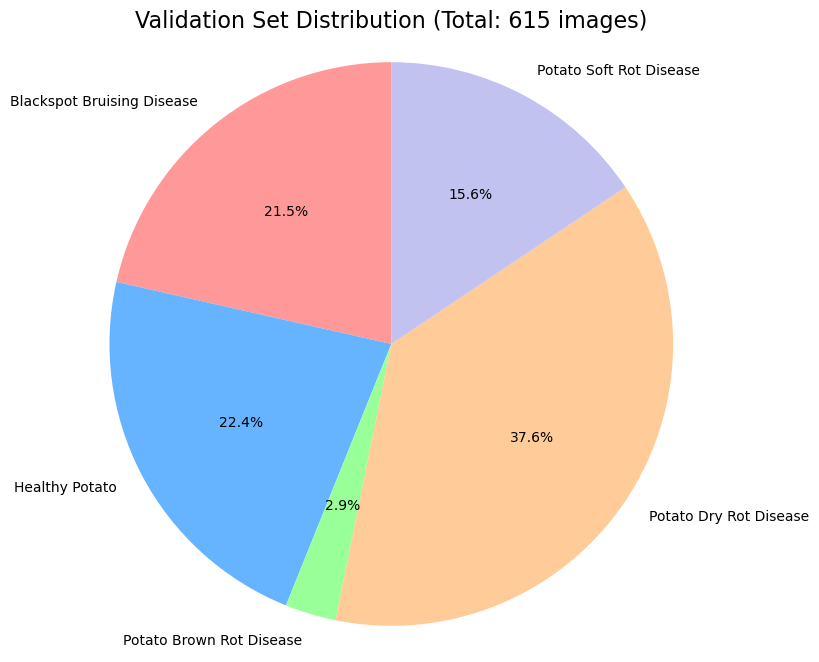

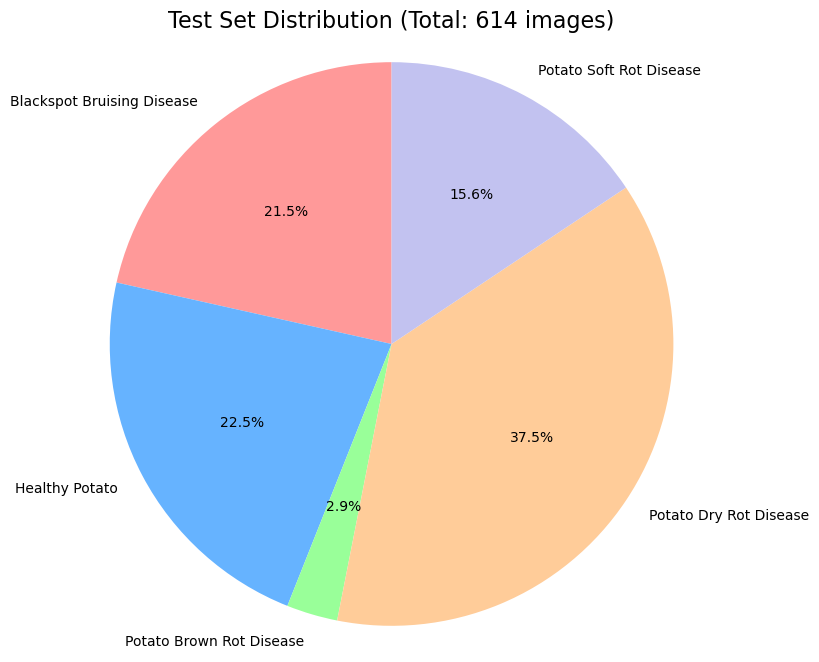

In [ ]:
import os
import glob
import matplotlib.pyplot as plt
import pandas as pd

# Define the function to count images
def count_images(path_pattern):
    return len(glob.glob(path_pattern))

# Paths to the root directory
root_dir = r"A:/tuberSplit"

# Consolidated class names
consolidated_classes = [
    "Blackspot Bruising Disease",
    "Healthy Potato",
    "Potato Brown Rot Disease",
    "Potato Dry Rot Disease",
    "Potato Soft Rot Disease",
]

# Function to generate class-specific paths
def generate_paths(root, subset, class_name):
    return os.path.join(root, subset, class_name, "*.jpg")

# Initialize image counts
image_counts = {class_name: {"train": 0, "val": 0, "test": 0} for class_name in consolidated_classes}

# Count images for each class and subset
for class_name in consolidated_classes:
    image_counts[class_name]["train"] = count_images(generate_paths(root_dir, "train", class_name))
    image_counts[class_name]["val"] = count_images(generate_paths(root_dir, "val", class_name))
    image_counts[class_name]["test"] = count_images(generate_paths(root_dir, "test", class_name))

# Create a DataFrame for better visualization
image_counts_df = pd.DataFrame(image_counts).T
image_counts_df["Total"] = image_counts_df.sum(axis=1)

# Print the table
print("Image Counts by Class and Subset:")
print(image_counts_df)

# Prepare data for pie charts
train_data = image_counts_df["train"].tolist()
val_data = image_counts_df["val"].tolist()
test_data = image_counts_df["test"].tolist()

# Function to plot pie charts
def plot_pie_chart(data, labels, title):
    plt.figure(figsize=(8, 8))
    plt.pie(data, labels=labels, autopct='%1.1f%%', startangle=90, colors=['#ff9999', '#66b3ff', '#99ff99', '#ffcc99', '#c2c2f0'])
    plt.title(title, fontsize=16)
    plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
    plt.show()

# Plot pie charts
# Plot training set distribution
plot_pie_chart(train_data, consolidated_classes, f'Training Set Distribution (Total: {sum(train_data)} images)')

# Plot validation set distribution
plot_pie_chart(val_data, consolidated_classes, f'Validation Set Distribution (Total: {sum(val_data)} images)')

# Plot test set distribution
plot_pie_chart(test_data, consolidated_classes, f'Test Set Distribution (Total: {sum(test_data)} images)')


In [ ]:
#EfficientNetV2B0

Found 2437 images belonging to 5 classes.
Found 521 images belonging to 5 classes.

24274472/24274472 ━━━━━━━━━━━━━━━━━━━━ 9s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, None,      │          0 │ -                 │
│ (InputLayer)        │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling           │ (None, None,      │          0 │ input_layer[0][0] │
│ (Rescaling)         │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ normalization       │ (None, None,      │          0 │ rescaling[0][0]   │
│ (Normalization)     │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_conv (Conv2D)  │ (None, None,      │        864 │ normalization[0]… │
│                     │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_bn             │ (None, None,      │        128 │ stem_conv[0][0]   │
│ (BatchNormalizatio… │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_activation     │ (None, None,      │          0 │ stem_bn[0][0]     │
│ (Activation)        │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_project_co… │ (None, None,      │      4,608 │ stem_activation[… │
│ (Conv2D)            │ None, 16)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_project_bn  │ (None, None,      │         64 │ block1a_project_… │
│ (BatchNormalizatio… │ None, 16)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_project_ac… │ (None, None,      │          0 │ block1a_project_… │
│ (Activation)        │ None, 16)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2a_expand_conv │ (None, None,      │      9,216 │ block1a_project_… │
│ (Conv2D)            │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2a_expand_bn   │ (None, None,      │        256 │ block2a_expand_c… │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2a_expand_act… │ (None, None,      │          0 │ block2a_expand_b… │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2a_project_co… │ (None, None,      │      2,048 │ block2a_expand_a… │
│ (Conv2D)            │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2a_project_bn  │ (None, None,      │        128 │ block2a_project_… │
│ (BatchNormalizatio… │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2b_expand_conv │ (None, None,      │     36,864 │ block2a_project_… │
│ (Conv2D)            │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2b_expand_bn   │ (None, None,      │        512 │ block2b_expand_c… │
│ (BatchNormalizatio… │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2b_expand_act… │ (None, None,      │          0 │ block2b_expand_b

 Total params: 6,248,533 (23.84 MB)

 Trainable params: 329,221 (1.26 MB)

 Non-trainable params: 5,919,312 (22.58 MB)

C:\Users\Arian\anaconda3\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.7587 - loss: 0.6531

C:\Users\Arian\anaconda3\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()



Epoch 1: val_loss improved from inf to 0.17154, saving model to best_efficientnetv2b0_weights.keras
77/77 ━━━━━━━━━━━━━━━━━━━━ 106s 1s/step - accuracy: 0.7598 - loss: 0.6503 - val_accuracy: 0.9501 - val_loss: 0.1715 - learning_rate: 0.0010
Epoch 2/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 648ms/step - accuracy: 0.9378 - loss: 0.1626
Epoch 2: val_loss improved from 0.17154 to 0.14334, saving model to best_efficientnetv2b0_weights.keras
77/77 ━━━━━━━━━━━━━━━━━━━━ 58s 748ms/step - accuracy: 0.9379 - loss: 0.1625 - val_accuracy: 0.9482 - val_loss: 0.1433 - learning_rate: 0.0010
Epoch 3/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 612ms/step - accuracy: 0.9604 - loss: 0.1099
Epoch 3: val_loss improved from 0.14334 to 0.12508, saving model to best_efficientnetv2b0_weights.keras
77/77 ━━━━━━━━━━━━━━━━━━━━ 55s 711ms/step - accuracy: 0.9603 - loss: 0.1100 - val_accuracy: 0.9616 - val_loss: 0.1251 - learning_rate: 0.0010
Epoch 4/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 615ms/step - accuracy: 0.9678 - loss: 0.0922
Epoch 4: 

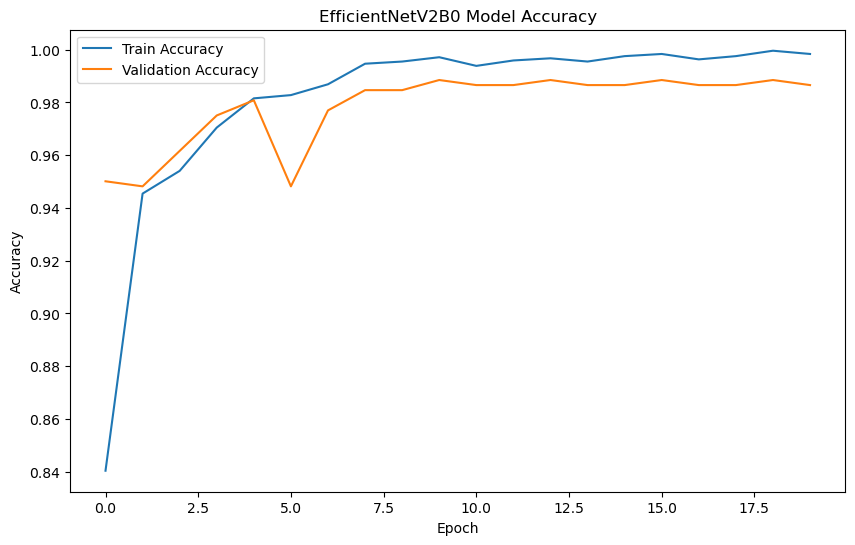

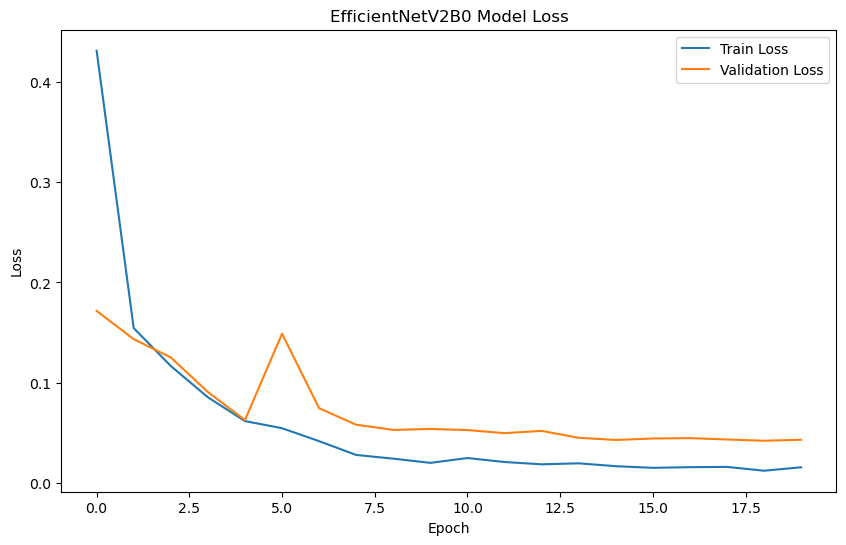

In [ ]:
import os
import math
from keras import backend as K
from keras.layers import Dense, GlobalAveragePooling2D, Dropout
from keras.applications import EfficientNetV2B0
from keras.applications.efficientnet_v2 import preprocess_input
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.models import Model
from keras.optimizers import Adam
from keras.callbacks import ReduceLROnPlateau, ModelCheckpoint
import matplotlib.pyplot as plt

# Define dataset paths
train_dir = "A:/tuberSplit/train"
val_dir = "A:/tuberSplit/val"

# Data augmentation and preprocessing
train_datagen = ImageDataGenerator(preprocessing_function=preprocess_input,
                                    zoom_range=0.1,
                                    horizontal_flip=True)
val_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

# Load training and validation data
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),
    color_mode='rgb',
    batch_size=32,
    class_mode='categorical',
    shuffle=True)

validation_generator = val_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    color_mode='rgb',
    batch_size=32,
    class_mode='categorical',
    shuffle=False)

# Clear previous sessions
K.clear_session()

# Learning rate reducer and checkpoint callback
lr_reduce = ReduceLROnPlateau(monitor='val_loss', factor=0.2,
                              patience=2, verbose=1, min_delta=0.0001)
filepath = "best_efficientnetv2b0_weights.keras"  # Save best weights for EfficientNetV2B0
checkpoint = ModelCheckpoint(filepath, monitor='val_loss',
                             verbose=1, save_best_only=True, mode='min')

# Load EfficientNetV2B0 base model
base_model = EfficientNetV2B0(weights='imagenet', include_top=False)
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu', kernel_initializer='he_normal')(x)
preds = Dense(train_generator.num_classes, activation='softmax')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=preds)

# Freeze base model layers
for layer in base_model.layers:
    layer.trainable = False

# Compile the model
opt = Adam(learning_rate=0.001)
model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

# Model summary
model.summary()

# Correct step size calculation
step_size_train = math.ceil(train_generator.n / train_generator.batch_size)
step_size_val = math.ceil(validation_generator.n / validation_generator.batch_size)

# Train the model
history = model.fit(train_generator,
                    validation_data=validation_generator,
                    steps_per_epoch=step_size_train,
                    validation_steps=step_size_val,
                    epochs=20,
                    callbacks=[lr_reduce, checkpoint])

# Plot training history
plt.figure(figsize=(10, 6))
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('EfficientNetV2B0 Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('EfficientNetV2B0 Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()



x_test shape: (527, 224, 224, 3)
y_test_true shape: (527,)
17/17 ━━━━━━━━━━━━━━━━━━━━ 11s 527ms/step
Model Accuracy: 98.48%

Classification Report:
                            precision    recall  f1-score   support

Blackspot Bruising Disease       0.97      1.00      0.98       113
            Healthy Potato       0.99      1.00      1.00       118
  Potato Brown Rot Disease       1.00      1.00      1.00        16
    Potato Dry Rot Disease       0.99      0.98      0.99       197
   Potato Soft Rot Disease       0.98      0.95      0.96        83

                  accuracy                           0.98       527
                 macro avg       0.99      0.99      0.99       527
              weighted avg       0.98      0.98      0.98       527

F1 Score: 0.98
F2 Score: 0.99


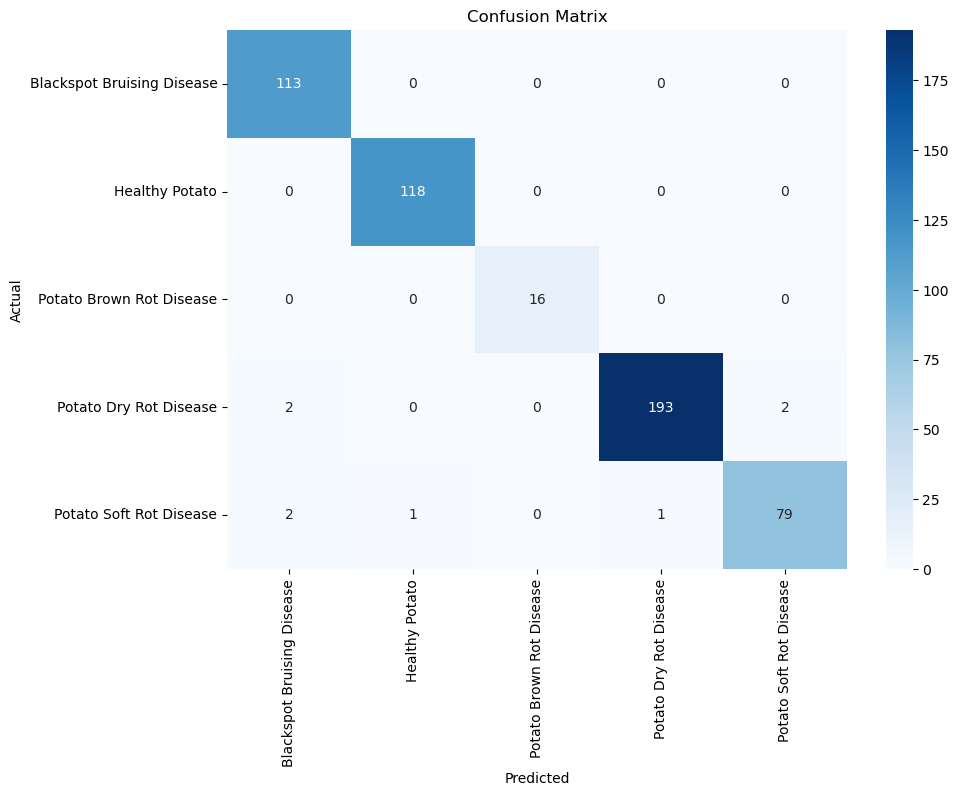

Recall: 0.99
Precision: 0.99


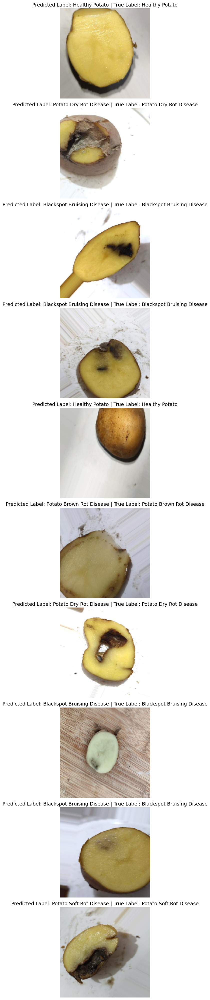

In [ ]:
import random
from keras.preprocessing import image
from sklearn.metrics import classification_report, f1_score
from keras.applications.efficientnet_v2 import preprocess_input
from sklearn.metrics import confusion_matrix
import numpy as np
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns

# Function to preprocess the image
def proc_img(img_path):
    """
    Process the image: Load, resize, and preprocess.
    """
    img = image.load_img(img_path, target_size=(224, 224))
    x_img = image.img_to_array(img)
    x_img = np.expand_dims(x_img, axis=0)
    x_img = preprocess_input(x_img)  # EfficientNetV2 preprocessing
    return x_img

# Define the test dataset path
test_path = Path("A:/tuberSplit/test")

# Automatically detect subdirectories as classes
classes = sorted([d.name for d in test_path.iterdir() if d.is_dir()])

# Get all images and their labels based on class indices
test_data = []
for class_index, class_name in enumerate(classes):
    class_dir = test_path / class_name
    for img in class_dir.glob('*.*'):  # Adjust extension filter if needed
        test_data.append((img, class_index))

# Create a DataFrame and shuffle
test_data = pd.DataFrame(test_data, columns=['image', 'label'])
test_data = test_data.sample(frac=1).reset_index(drop=True)

# Prepare x_test and y_test
num_samples = len(test_data)
x_test = np.zeros((num_samples, 224, 224, 3), dtype=np.float32)
y_test_true = np.array(test_data['label'], dtype=np.int32)

# Process images
for i, img_path in enumerate(test_data['image']):
    x_test[i] = proc_img(str(img_path))

# Debugging checks before prediction
print(f"x_test shape: {x_test.shape}")
print(f"y_test_true shape: {y_test_true.shape}")

# Predict the labels
y_test_pred = np.argmax(model.predict(x_test, verbose=1), axis=1)

# Calculate and print accuracy
accuracy = np.mean(y_test_pred == y_test_true)
print(f"Model Accuracy: {accuracy * 100:.2f}%")

# Classification Report
print("\nClassification Report:")
print(classification_report(y_test_true, y_test_pred, target_names=classes))

# F1 and F2 Scores
f1 = f1_score(y_test_true, y_test_pred, average='weighted')
print(f"F1 Score: {f1:.2f}")

# F2 Score (using beta=2)
def fbeta_score(y_true, y_pred, beta=2):
    """
    Compute F-beta score.
    """
    cm = confusion_matrix(y_true, y_pred)
    tp = np.diag(cm)
    fp = cm.sum(axis=0) - tp
    fn = cm.sum(axis=1) - tp
    precision = tp / (tp + fp + 1e-10)
    recall = tp / (tp + fn + 1e-10)
    beta_squared = beta ** 2
    fbeta = np.mean((1 + beta_squared) * (precision * recall) / (beta_squared * precision + recall + 1e-10))
    return fbeta

f2 = fbeta_score(y_test_true, y_test_pred, beta=2)
print(f"F2 Score: {f2:.2f}")

# Confusion Matrix
cm = confusion_matrix(y_test_true, y_test_pred)

# Plot confusion matrix using seaborn
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=classes, yticklabels=classes)
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.show()

# Metrics Calculation
def recall(y_true, y_pred):
    """
    Compute recall from confusion matrix.
    """
    cm = confusion_matrix(y_true, y_pred)
    tp = np.diag(cm)
    fn = cm.sum(axis=1) - tp
    return np.mean(tp / (tp + fn + 1e-10))

def precision(y_true, y_pred):
    """
    Compute precision from confusion matrix.
    """
    cm = confusion_matrix(y_true, y_pred)
    tp = np.diag(cm)
    fp = cm.sum(axis=0) - tp
    return np.mean(tp / (tp + fp + 1e-10))

# Print metrics
recall_value = recall(y_test_true, y_test_pred)
precision_value = precision(y_test_true, y_test_pred)
print(f"Recall: {recall_value:.2f}")
print(f"Precision: {precision_value:.2f}")

# Show 10 images with predicted and true labels
plt.figure(figsize=(20, 40))

random_indices = random.sample(range(len(x_test)), 10)

for i, idx in enumerate(random_indices):
    plt.subplot(10, 1, i + 1)
    image_to_show = x_test[idx]

    # Convert image for display if required
    if np.max(image_to_show) <= 1.0:  # If normalized (0 to 1), scale up
        image_to_show = (image_to_show * 255).astype(np.uint8)

    plt.imshow(image_to_show.astype(np.uint8))

    # Predicted and true labels
    predicted_label = classes[y_test_pred[idx]]
    true_label = classes[y_test_true[idx]]
    plt.title(f"Predicted Label: {predicted_label} | True Label: {true_label}", fontsize=14, color="black")
    plt.axis('off')

plt.tight_layout()
plt.show()


C:\Users\Arian\anaconda3\Lib\site-packages\keras\src\models\functional.py:238: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['keras_tensor']]
Received: inputs=Tensor(shape=(1, 224, 224, 3))
  warnings.warn(msg)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step


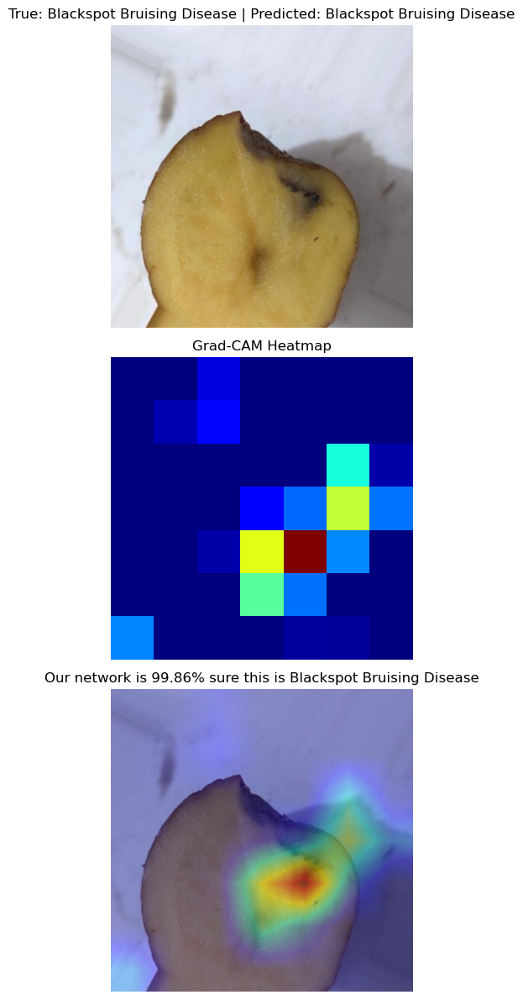

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


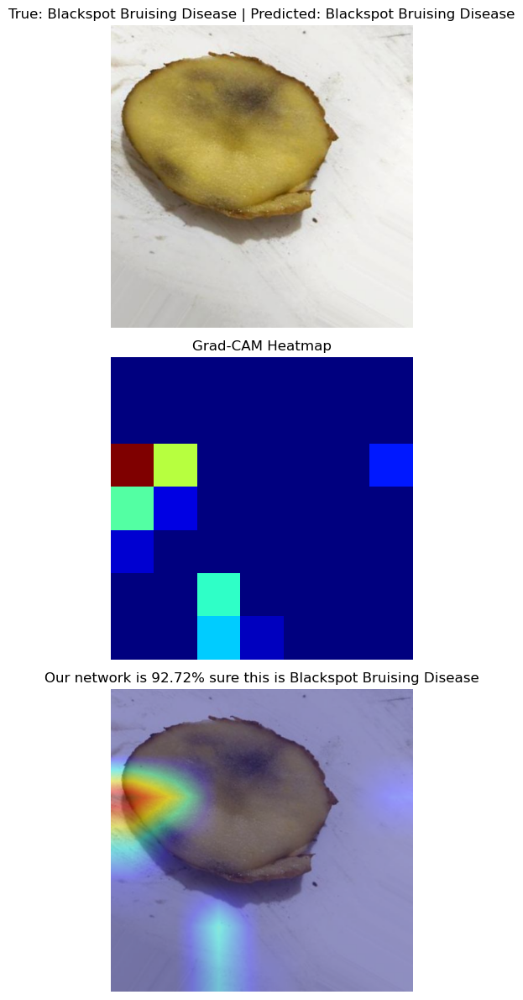

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step


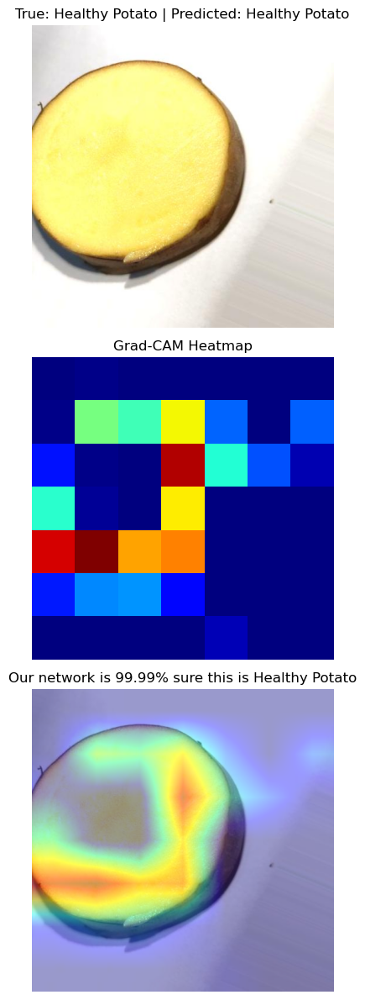

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


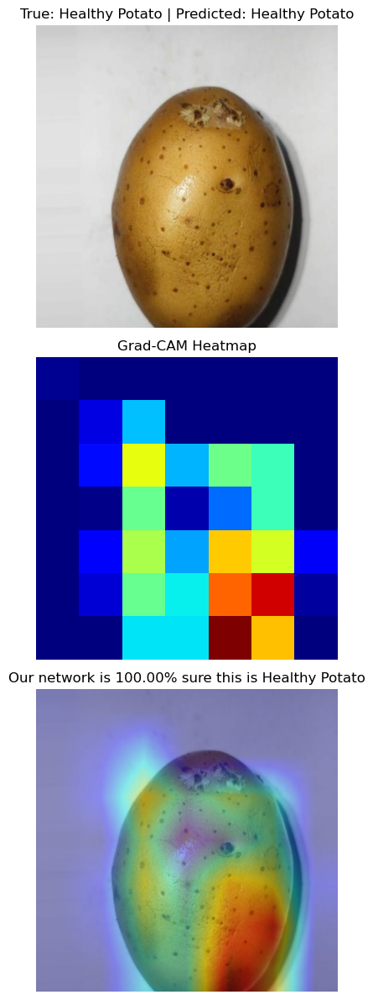

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


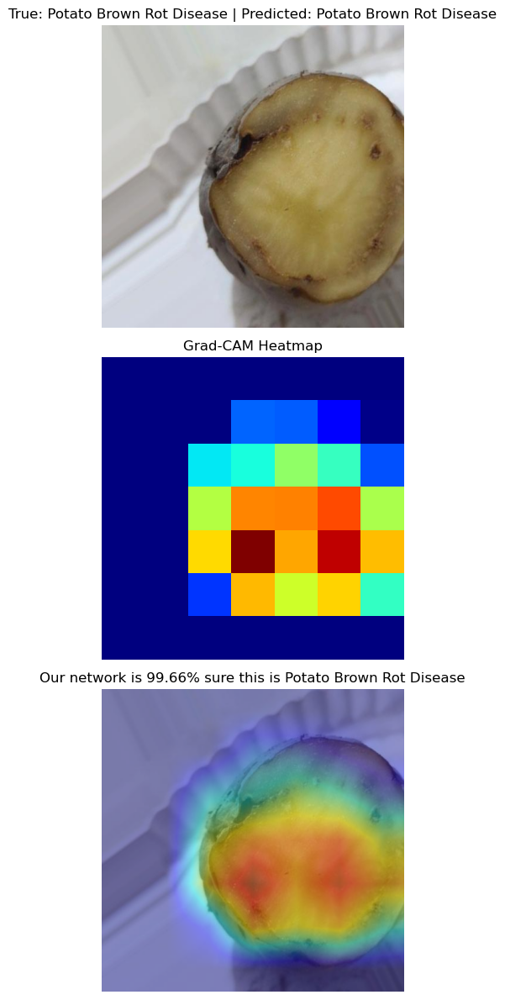

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


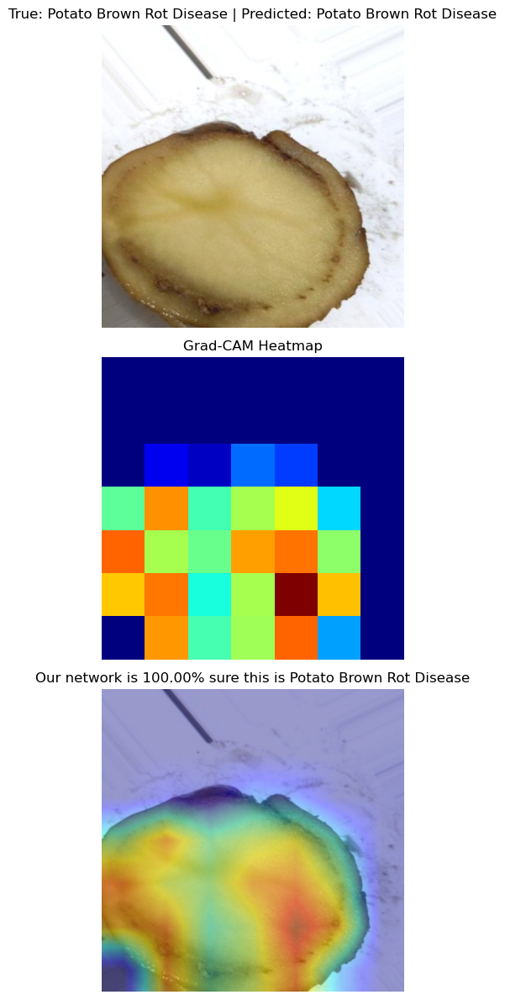

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step


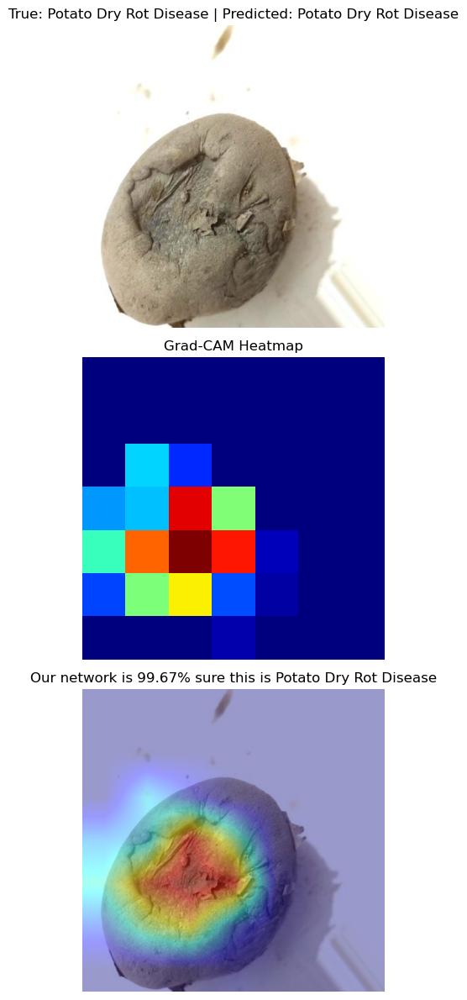

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


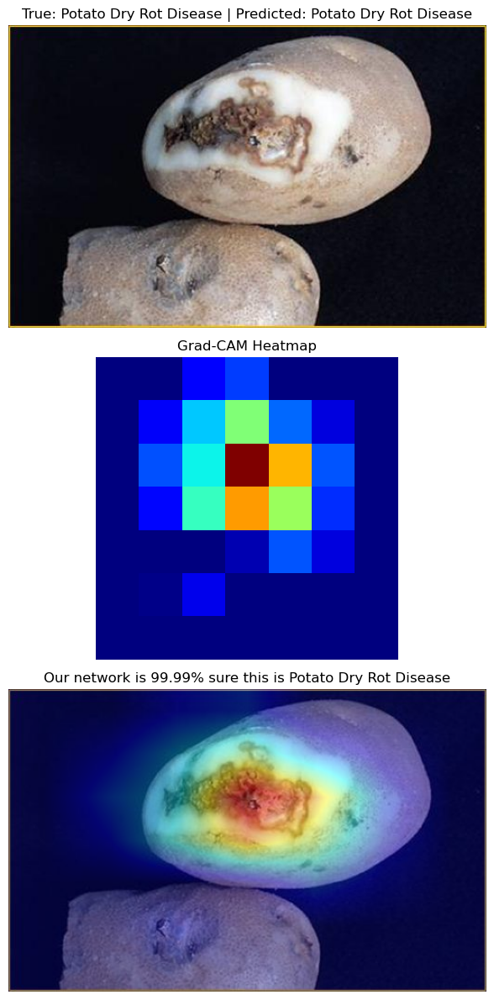

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


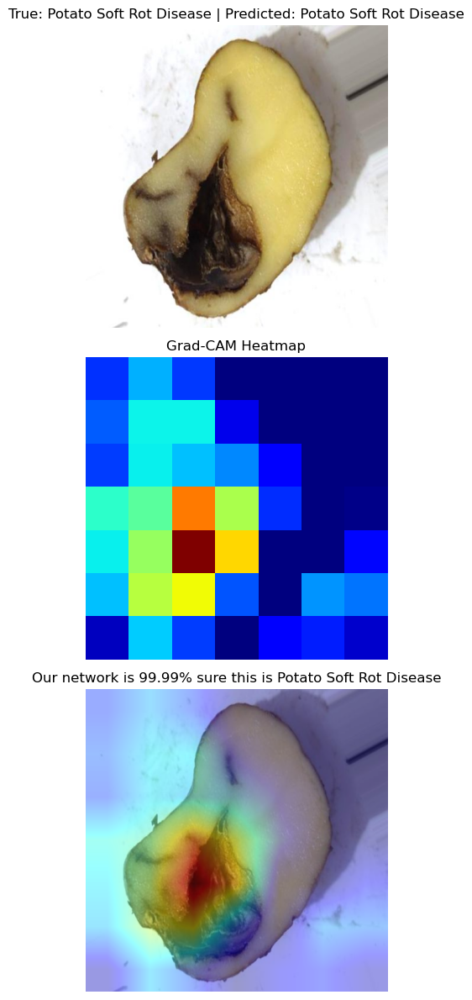

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


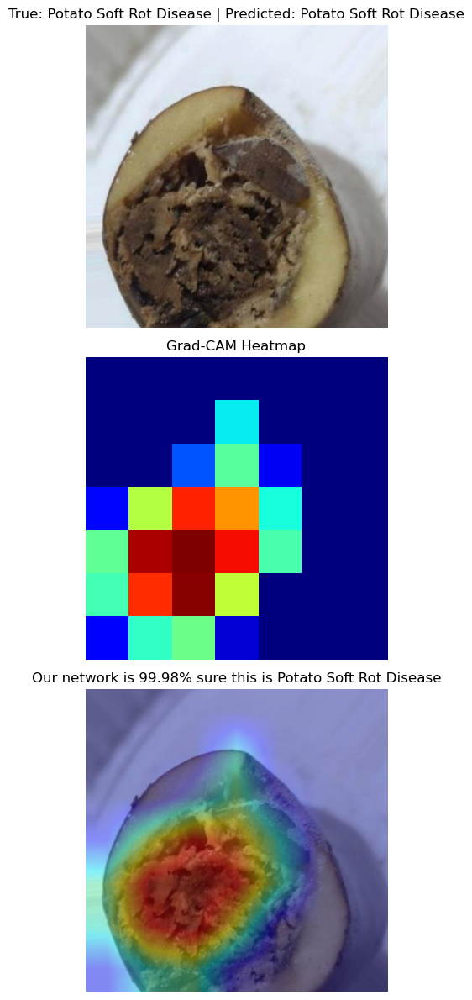

In [ ]:
import cv2
import random
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model
from tensorflow.keras import backend as K
from pathlib import Path
import tensorflow as tf
from tensorflow.keras.preprocessing import image
from keras.applications.efficientnet_v2 import preprocess_input

# Define Grad-CAM functions
def generate_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    """
    Generate Grad-CAM heatmap for a given image and model.
    """
    # Create a model that maps the input image to the activations of the last conv layer and the predictions
    grad_model = Model([model.inputs], [model.get_layer(last_conv_layer_name).output, model.output])

    with tf.GradientTape() as tape:
        # Forward pass
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = np.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    # Compute gradients of the class output value with respect to the feature map
    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = K.mean(grads, axis=(0, 1, 2))

    # Compute the weighted sum of feature maps
    conv_outputs = conv_outputs[0]
    heatmap = np.dot(conv_outputs, pooled_grads[..., np.newaxis])
    heatmap = np.squeeze(heatmap)

    # Normalize heatmap between 0 and 1
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap) + 1e-10
    return heatmap

def superimpose_gradcam(img_path, heatmap, intensity=0.4):
    """
    Overlay the Grad-CAM heatmap on the original image.
    """
    img = cv2.imread(img_path)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed_img = cv2.addWeighted(heatmap, intensity, img, 1 - intensity, 0)
    return cv2.cvtColor(superimposed_img, cv2.COLOR_BGR2RGB)

# Define classes for visualization
class_labels = ['Blackspot Bruising Disease', 'Healthy Potato', 'Potato Brown Rot Disease', 'Potato Dry Rot Disease', 'Potato Soft Rot Disease']
last_conv_layer_name = 'top_conv'  # EfficientNetV2B0's last convolutional layer

# Randomly select 2 images per class for visualization
random_images = []
for class_index, class_name in enumerate(class_labels):
    class_dir = Path(f"A:/tuberSplit/test/{class_name}")
    all_images = list(class_dir.glob('*.*'))  # Adjust file extensions as needed
    selected_images = random.sample(all_images, 2)
    random_images.extend([(str(img_path), class_index) for img_path in selected_images])

# Preprocess the image (for EfficientNetV2B0)
def proc_img(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = preprocess_input(img_array)  # EfficientNetV2B0-specific preprocessing
    return img_array

# Create a new figure for each image
for i, (img_path, true_label) in enumerate(random_images):
    # Preprocess the image
    img_array = proc_img(img_path)

    # Generate Grad-CAM heatmap
    heatmap = generate_gradcam_heatmap(img_array, model, last_conv_layer_name)

    # Superimpose heatmap on the original image
    gradcam_img = superimpose_gradcam(img_path, heatmap)

    # Display images in separate figures
    fig, axes = plt.subplots(3, 1, figsize=(8, 12))

    # Original image
    axes[0].imshow(cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB))
    axes[0].set_title(f"True: {class_labels[true_label]} | Predicted: {class_labels[np.argmax(model.predict(img_array))]}")
    axes[0].axis('off')

    # Heatmap (mask)
    axes[1].imshow(heatmap, cmap='jet')
    axes[1].set_title("Grad-CAM Heatmap")
    axes[1].axis('off')

    # Grad-CAM superimposed image
    axes[2].imshow(gradcam_img)
    confidence = np.max(model.predict(img_array)) * 100
    predicted_label = class_labels[np.argmax(model.predict(img_array))]
    axes[2].set_title(f"Our network is {confidence:.2f}% sure this is {predicted_label}")
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()


In [ ]:
#InceptionResNetV2

Found 2437 images belonging to 5 classes.
Found 521 images belonging to 5 classes.
219055592/219055592 ━━━━━━━━━━━━━━━━━━━━ 135s 1us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, None,      │          0 │ -                 │
│ (InputLayer)        │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, None,      │        864 │ input_layer[0][0] │
│                     │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, None,      │         96 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation          │ (None, None,      │          0 │ batch_normalizat… │
│ (Activation)        │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, None,      │      9,216 │ activation[0][0]  │
│                     │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, None,      │         96 │ conv2d_1[0][0]    │
│ (BatchNormalizatio… │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_1        │ (None, None,      │          0 │ batch_normalizat… │
│ (Activation)        │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, None,      │     18,432 │ activation_1[0][… │
│                     │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, None,      │        192 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_2        │ (None, None,      │          0 │ batch_normalizat… │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, None,      │          0 │ activation_2[0][… │
│ (MaxPooling2D)      │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, None,      │      5,120 │ max_pooling2d[0]… │
│                     │ None, 80)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, None,      │        240 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ None, 80)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_3        │ (None, None,      │          0 │ batch_normalizat… │
│ (Activation)        │ None, 80)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, None,      │    138,240 │ activation_3[0][… │
│                     │ None, 192)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, None,      │        576 │ conv2d_4[0][0]    │
│ (BatchNormalizatio… │ None, 192)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ activation_4        │ (None, None,      │          0 │ batch_normalizat

 Total params: 54,731,493 (208.78 MB)

 Trainable params: 394,757 (1.51 MB)

 Non-trainable params: 54,336,736 (207.28 MB)

C:\Users\Arian\anaconda3\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.6351 - loss: 1.0026
Epoch 1: val_loss improved from inf to 0.40479, saving model to best_inception_resnetv2_weights.keras
77/77 ━━━━━━━━━━━━━━━━━━━━ 308s 4s/step - accuracy: 0.6364 - loss: 0.9990 - val_accuracy: 0.8522 - val_loss: 0.4048 - learning_rate: 0.0010
Epoch 2/10
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.8606 - loss: 0.3881
Epoch 2: val_loss improved from 0.40479 to 0.29806, saving model to best_inception_resnetv2_weights.keras
77/77 ━━━━━━━━━━━━━━━━━━━━ 281s 4s/step - accuracy: 0.8607 - loss: 0.3877 - val_accuracy: 0.8887 - val_loss: 0.2981 - learning_rate: 0.0010
Epoch 3/10
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 3s/step - accuracy: 0.8958 - loss: 0.3048
Epoch 3: val_loss improved from 0.29806 to 0.27184, saving model to best_inception_resnetv2_weights.keras
77/77 ━━━━━━━━━━━━━━━━━━━━ 284s 4s/step - accuracy: 0.8958 - loss: 0.3047 - val_accuracy: 0.8868 - val_loss: 0.2718 - learning_rate: 0.0010
Epoch 4/10
77/77 

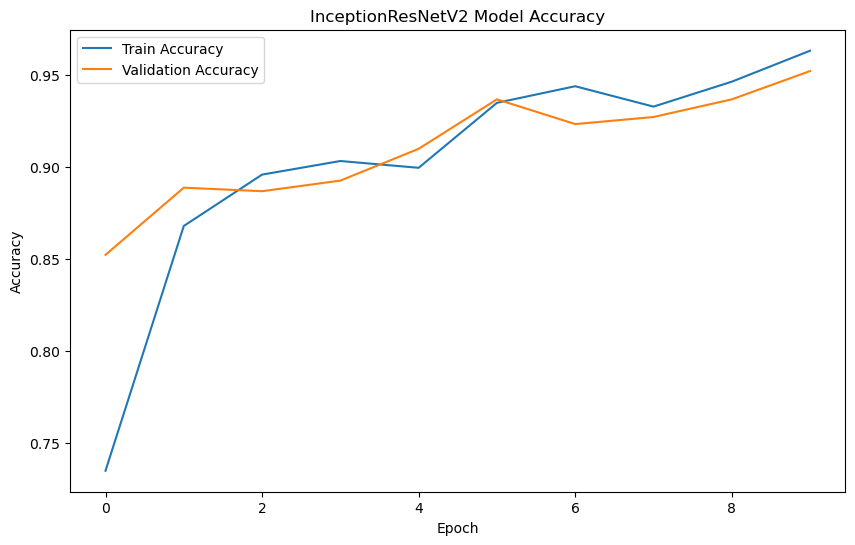

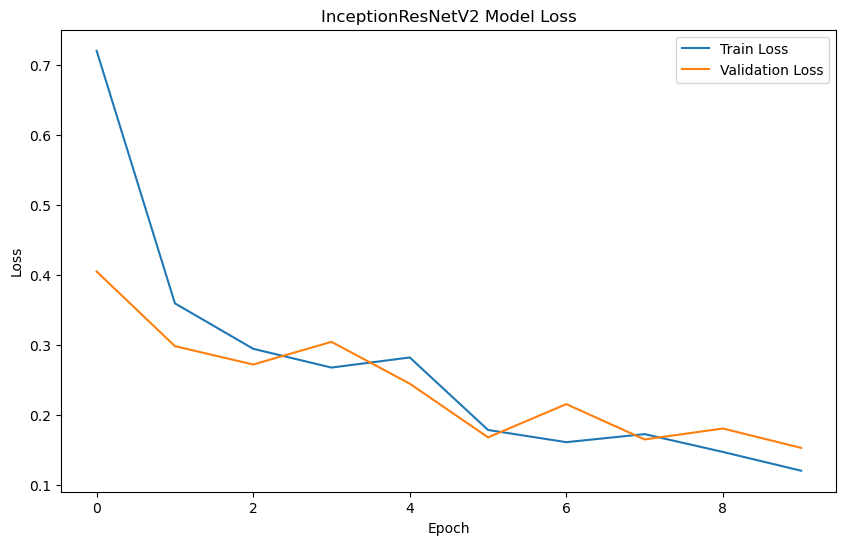

In [ ]:
import os
import math
from keras import backend as K
from keras.layers import Dense, GlobalAveragePooling2D, Dropout
from keras.applications import InceptionResNetV2
from keras.applications.inception_resnet_v2 import preprocess_input
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.models import Model
from keras.optimizers import Adam
from keras.callbacks import ReduceLROnPlateau, ModelCheckpoint
import matplotlib.pyplot as plt

# Define dataset paths
train_dir = "A:/tuberSplit/train"
val_dir = "A:/tuberSplit/val"

# Data augmentation and preprocessing
train_datagen = ImageDataGenerator(preprocessing_function=preprocess_input,
                                    zoom_range=0.1,
                                    horizontal_flip=True)
val_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

# Load training and validation data
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(299, 299),  # InceptionResNetV2 requires 299x299 images
    color_mode='rgb',
    batch_size=32,
    class_mode='categorical',
    shuffle=True)

validation_generator = val_datagen.flow_from_directory(
    val_dir,
    target_size=(299, 299),
    color_mode='rgb',
    batch_size=32,
    class_mode='categorical',
    shuffle=False)

# Clear previous sessions
K.clear_session()

# Learning rate reducer and checkpoint callback
lr_reduce = ReduceLROnPlateau(monitor='val_loss', factor=0.2,
                              patience=2, verbose=1, min_delta=0.0001)
filepath = "best_inception_resnetv2_weights.keras"  # Save best weights for InceptionResNetV2
checkpoint = ModelCheckpoint(filepath, monitor='val_loss',
                             verbose=1, save_best_only=True, mode='min')

# Load InceptionResNetV2 base model
base_model = InceptionResNetV2(weights='imagenet', include_top=False)
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu', kernel_initializer='he_normal')(x)
preds = Dense(train_generator.num_classes, activation='softmax')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=preds)

# Freeze base model layers
for layer in base_model.layers:
    layer.trainable = False

# Compile the model
opt = Adam(learning_rate=0.001)
model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

# Model summary
model.summary()

# Correct step size calculation
step_size_train = math.ceil(train_generator.n / train_generator.batch_size)
step_size_val = math.ceil(validation_generator.n / validation_generator.batch_size)

# Train the model
history = model.fit(train_generator,
                    validation_data=validation_generator,
                    steps_per_epoch=step_size_train,
                    validation_steps=step_size_val,
                    epochs=10,
                    callbacks=[lr_reduce, checkpoint])

# Plot training history
plt.figure(figsize=(10, 6))
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('InceptionResNetV2 Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('InceptionResNetV2 Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()


C:\Users\Arian\anaconda3\Lib\site-packages\keras\src\saving\saving_lib.py:757: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 10 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))


Number of classes: 5
Classes: ['Blackspot Bruising Disease', 'Healthy Potato', 'Potato Brown Rot Disease', 'Potato Dry Rot Disease', 'Potato Soft Rot Disease']
x_test shape: (527, 299, 299, 3)
y_test_true shape: (527,)
17/17 ━━━━━━━━━━━━━━━━━━━━ 55s 3s/step
Model Accuracy: 93.55%

Classification Report:
                            precision    recall  f1-score   support

Blackspot Bruising Disease       0.85      0.99      0.91       113
            Healthy Potato       1.00      1.00      1.00       118
  Potato Brown Rot Disease       0.94      0.94      0.94        16
    Potato Dry Rot Disease       0.97      0.92      0.95       197
   Potato Soft Rot Disease       0.89      0.80      0.84        83

                  accuracy                           0.94       527
                 macro avg       0.93      0.93      0.93       527
              weighted avg       0.94      0.94      0.94       527

F1 Score: 0.94
F2 Score: 0.93


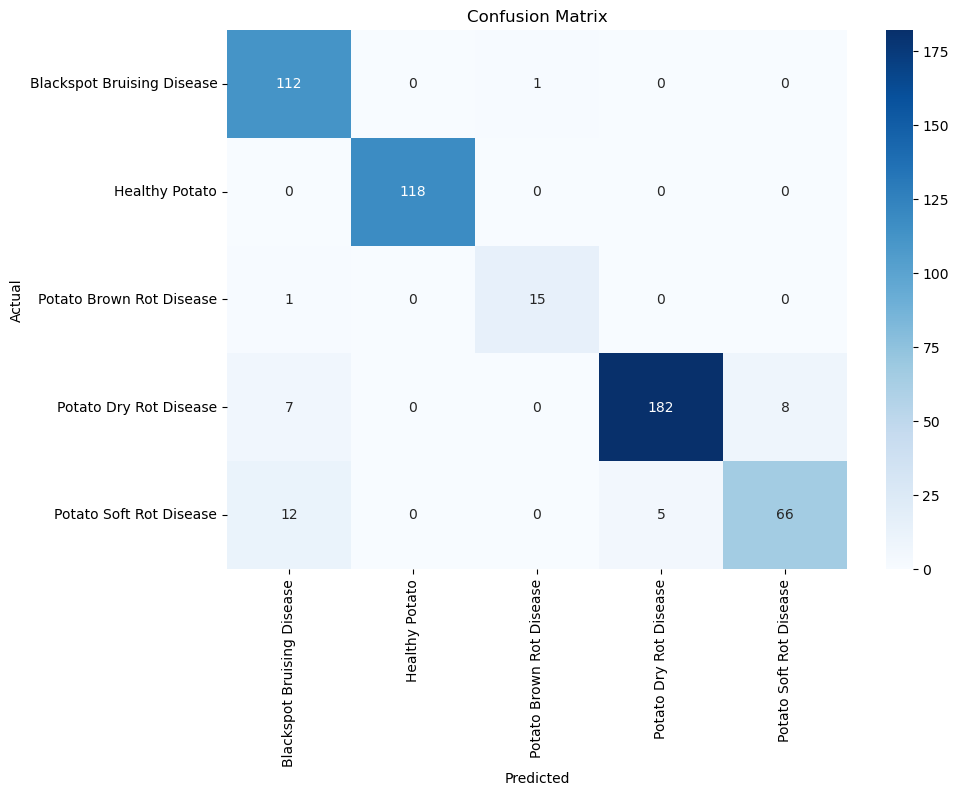

Recall: 0.93
Precision: 0.93


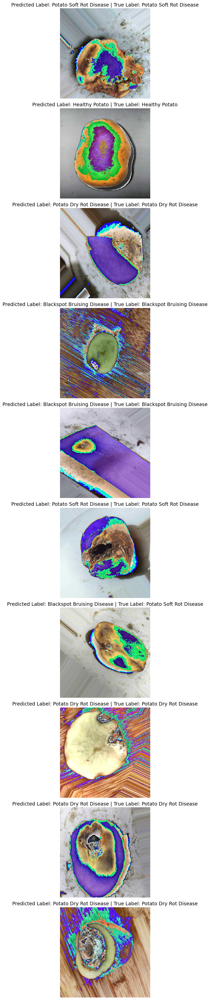

In [ ]:
import random
from keras.preprocessing import image
from sklearn.metrics import classification_report, f1_score
from keras.applications.inception_resnet_v2 import InceptionResNetV2, preprocess_input
from sklearn.metrics import confusion_matrix
import numpy as np
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns
from keras.models import Model
from keras.layers import GlobalAveragePooling2D, Dense
from keras.optimizers import Adam

# Load InceptionResNetV2 model with pre-trained weights, but without the top layers
base_model = InceptionResNetV2(weights='imagenet', include_top=False)

# Add custom top layers for your specific dataset
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu')(x)
predictions = Dense(5, activation='softmax')(x)  # 5 classes in your dataset

# Create the new model
model = Model(inputs=base_model.input, outputs=predictions)

# Freeze base model layers to prevent retraining
for layer in base_model.layers:
    layer.trainable = False

# Compile the model
model.compile(optimizer=Adam(learning_rate=0.001), loss='categorical_crossentropy', metrics=['accuracy'])

# Load the trained weights (if you have already trained the model and saved weights)
model.load_weights('best_inception_resnetv2_weights.keras')

# Function to preprocess the image
def proc_img(img_path):
    """
    Process the image: Load, resize, and preprocess.
    """
    img = image.load_img(img_path, target_size=(299, 299))  # InceptionResNetV2 requires 299x299
    x_img = image.img_to_array(img)
    x_img = np.expand_dims(x_img, axis=0)
    x_img = preprocess_input(x_img)  # InceptionResNetV2 preprocessing
    return x_img

# Define the test dataset path
test_path = Path("A:/tuberSplit/test")

# Automatically detect subdirectories as classes
classes = sorted([d.name for d in test_path.iterdir() if d.is_dir()])

# Debugging: Check the number of classes
print(f"Number of classes: {len(classes)}")
print(f"Classes: {classes}")

# Get all images and their labels based on class indices
test_data = []
for class_index, class_name in enumerate(classes):
    class_dir = test_path / class_name
    for img in class_dir.glob('*.*'):  # Adjust extension filter if needed
        test_data.append((img, class_index))

# Create a DataFrame and shuffle
test_data = pd.DataFrame(test_data, columns=['image', 'label'])
test_data = test_data.sample(frac=1).reset_index(drop=True)

# Prepare x_test and y_test
num_samples = len(test_data)
x_test = np.zeros((num_samples, 299, 299, 3), dtype=np.float32)  # InceptionResNetV2 expects 299x299
y_test_true = np.array(test_data['label'], dtype=np.int32)

# Process images
for i, img_path in enumerate(test_data['image']):
    x_test[i] = proc_img(str(img_path))

# Debugging checks before prediction
print(f"x_test shape: {x_test.shape}")
print(f"y_test_true shape: {y_test_true.shape}")

# Predict the labels
y_test_pred = np.argmax(model.predict(x_test, verbose=1), axis=1)

# Calculate and print accuracy
accuracy = np.mean(y_test_pred == y_test_true)
print(f"Model Accuracy: {accuracy * 100:.2f}%")

# Classification Report
print("\nClassification Report:")
print(classification_report(y_test_true, y_test_pred, target_names=classes))

# F1 and F2 Scores
f1 = f1_score(y_test_true, y_test_pred, average='weighted')
print(f"F1 Score: {f1:.2f}")

# F2 Score (using beta=2)
def fbeta_score(y_true, y_pred, beta=2):
    """
    Compute F-beta score.
    """
    cm = confusion_matrix(y_true, y_pred)
    tp = np.diag(cm)
    fp = cm.sum(axis=0) - tp
    fn = cm.sum(axis=1) - tp
    precision = tp / (tp + fp + 1e-10)
    recall = tp / (tp + fn + 1e-10)
    beta_squared = beta ** 2
    fbeta = np.mean((1 + beta_squared) * (precision * recall) / (beta_squared * precision + recall + 1e-10))
    return fbeta

f2 = fbeta_score(y_test_true, y_test_pred, beta=2)
print(f"F2 Score: {f2:.2f}")

# Confusion Matrix
cm = confusion_matrix(y_test_true, y_test_pred)

# Plot confusion matrix using seaborn
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=classes, yticklabels=classes)
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.show()

# Metrics Calculation
def recall(y_true, y_pred):
    """
    Compute recall from confusion matrix.
    """
    cm = confusion_matrix(y_true, y_pred)
    tp = np.diag(cm)
    fn = cm.sum(axis=1) - tp
    return np.mean(tp / (tp + fn + 1e-10))

def precision(y_true, y_pred):
    """
    Compute precision from confusion matrix.
    """
    cm = confusion_matrix(y_true, y_pred)
    tp = np.diag(cm)
    fp = cm.sum(axis=0) - tp
    return np.mean(tp / (tp + fp + 1e-10))

# Print metrics
recall_value = recall(y_test_true, y_test_pred)
precision_value = precision(y_test_true, y_test_pred)
print(f"Recall: {recall_value:.2f}")
print(f"Precision: {precision_value:.2f}")

# Show 10 images with predicted and true labels
plt.figure(figsize=(20, 40))

random_indices = random.sample(range(len(x_test)), 10)

for i, idx in enumerate(random_indices):
    plt.subplot(10, 1, i + 1)
    image_to_show = x_test[idx]

    # Convert image for display if required
    if np.max(image_to_show) <= 1.0:  # If normalized (0 to 1), scale up
        image_to_show = (image_to_show * 255).astype(np.uint8)

    # No need to convert BGR to RGB for InceptionResNetV2 preprocessing
    plt.imshow(image_to_show.astype(np.uint8))

    # Predicted and true labels
    predicted_label = classes[y_test_pred[idx]]
    true_label = classes[y_test_true[idx]]
    plt.title(f"Predicted Label: {predicted_label} | True Label: {true_label}", fontsize=14, color="black")
    plt.axis('off')

plt.tight_layout()
plt.show()




C:\Users\Arian\anaconda3\Lib\site-packages\keras\src\models\functional.py:238: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['keras_tensor_5476']]
Received: inputs=Tensor(shape=(1, 299, 299, 3))
  warnings.warn(msg)


1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 157ms/step


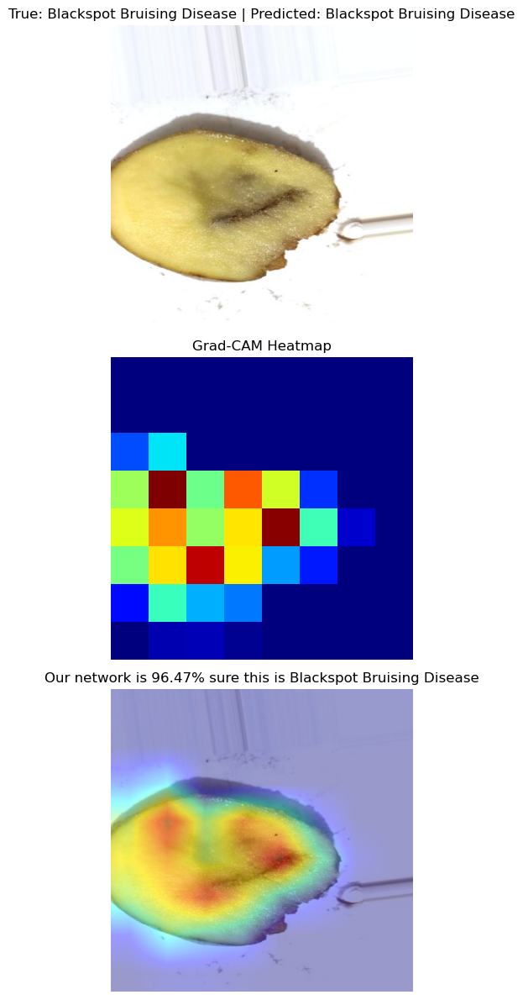

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 159ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 178ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step


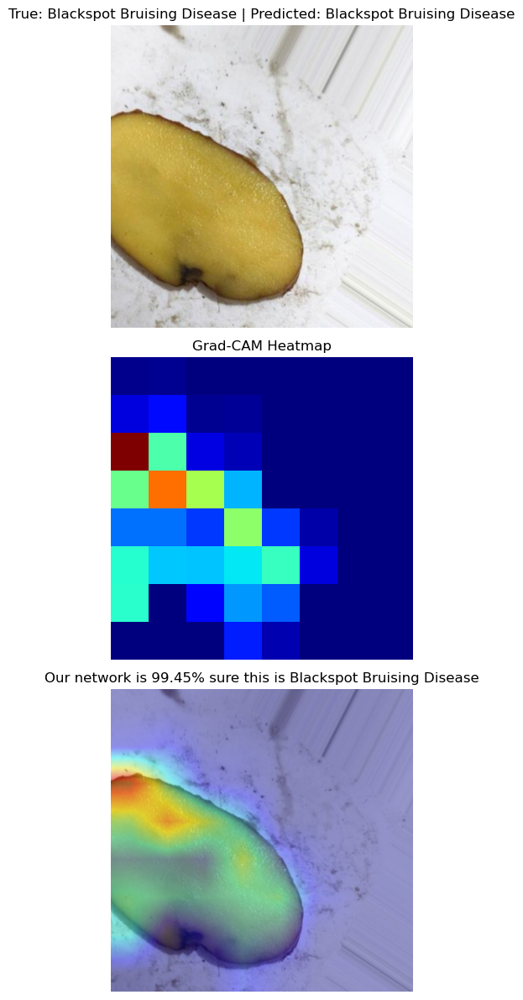

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 156ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


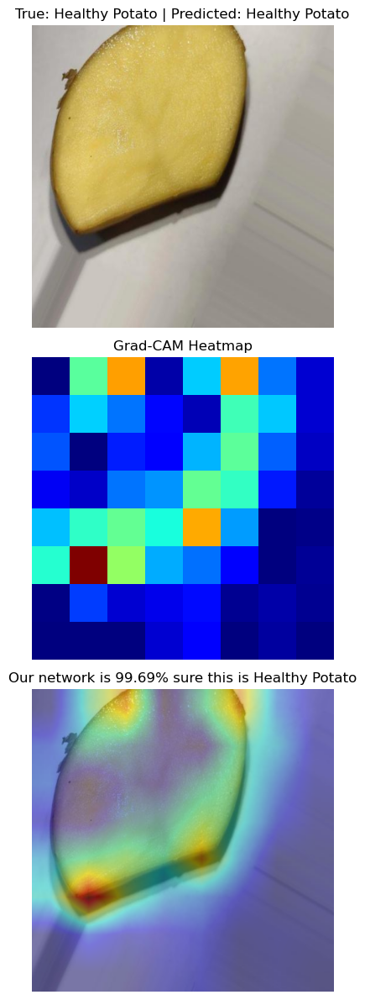

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 162ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 155ms/step


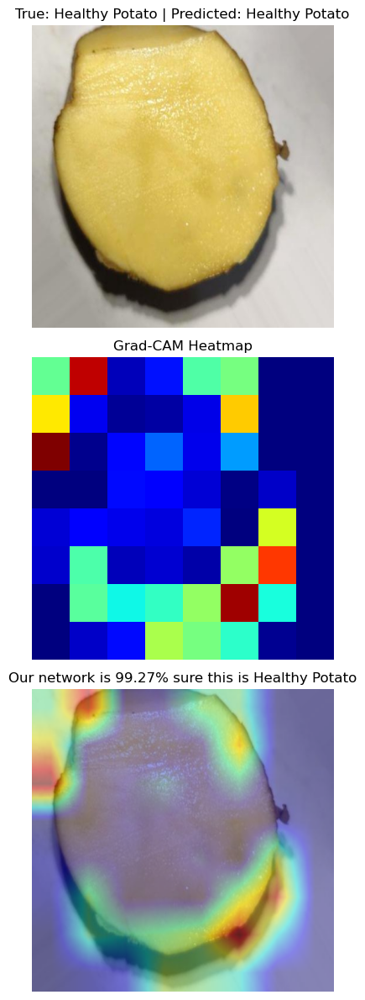

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 180ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 163ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step


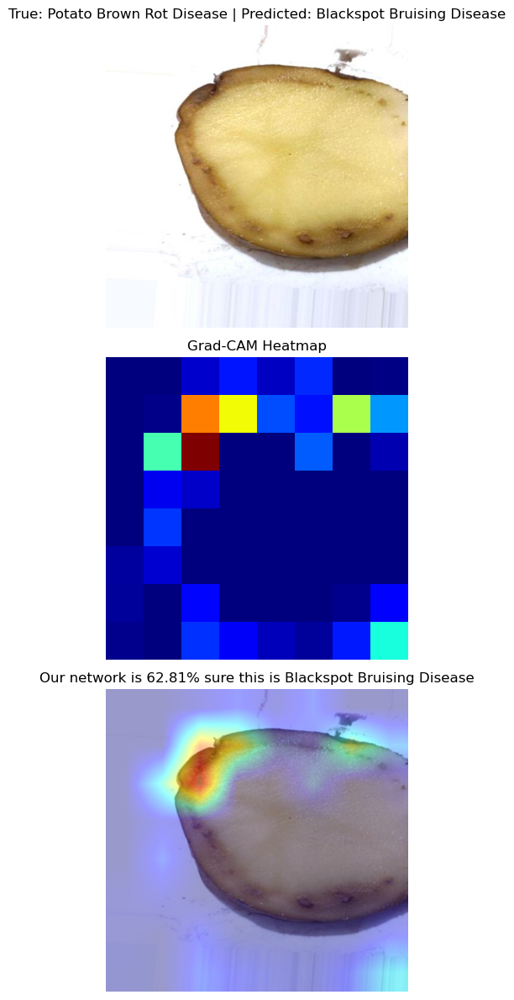

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 175ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step


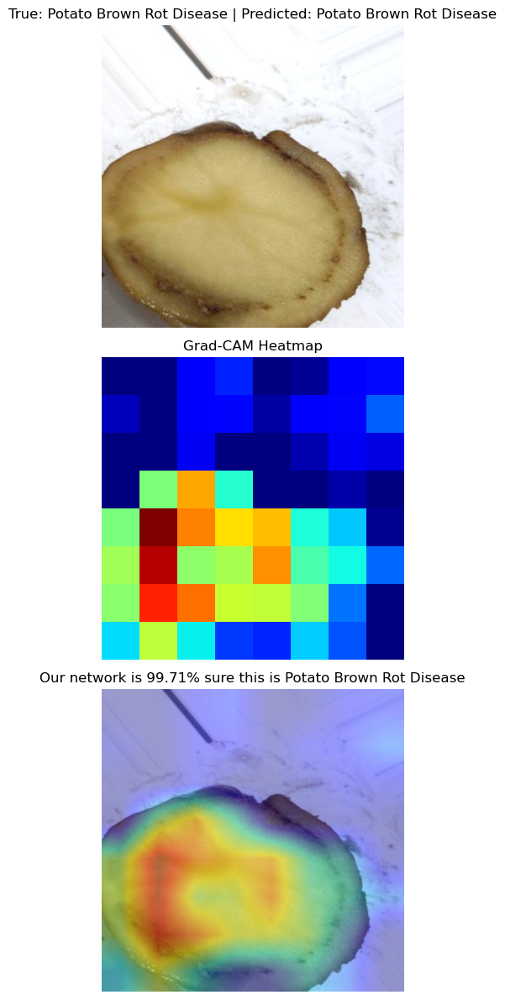

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 164ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step


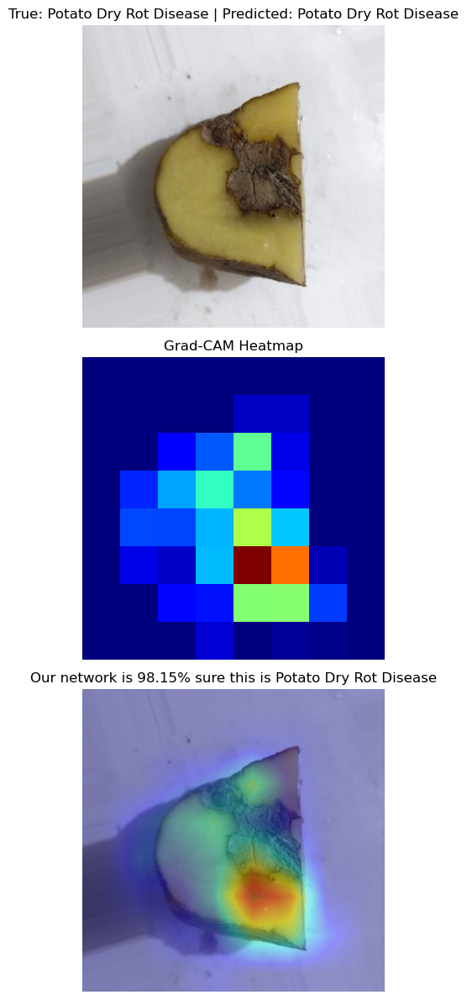

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 184ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step


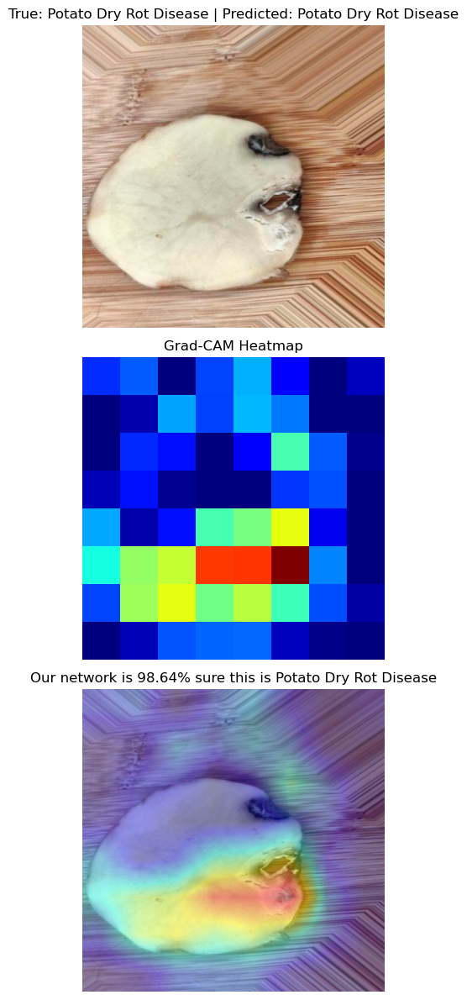

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 153ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 176ms/step


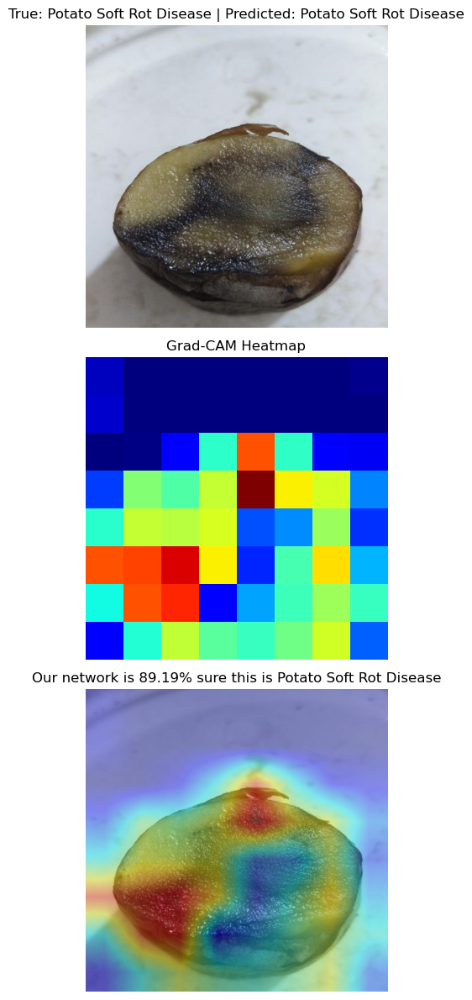

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 182ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 177ms/step


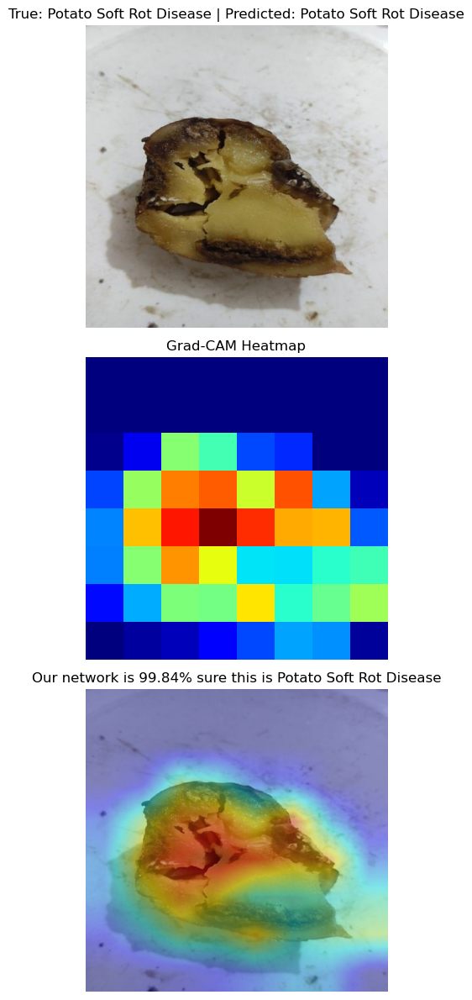

In [ ]:
import cv2
import random
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model
from tensorflow.keras import backend as K
from pathlib import Path
import tensorflow as tf
from tensorflow.keras.preprocessing import image
from keras.applications.inception_resnet_v2 import preprocess_input

# Define Grad-CAM functions
def generate_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    """
    Generate Grad-CAM heatmap for a given image and model.
    """
    # Create a model that maps the input image to the activations of the last conv layer and the predictions
    grad_model = Model([model.inputs], [model.get_layer(last_conv_layer_name).output, model.output])

    with tf.GradientTape() as tape:
        # Forward pass
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = np.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    # Compute gradients of the class output value with respect to the feature map
    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = K.mean(grads, axis=(0, 1, 2))

    # Compute the weighted sum of feature maps
    conv_outputs = conv_outputs[0]
    heatmap = np.dot(conv_outputs, pooled_grads[..., np.newaxis])
    heatmap = np.squeeze(heatmap)

    # Normalize heatmap between 0 and 1
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap) + 1e-10
    return heatmap

def superimpose_gradcam(img_path, heatmap, intensity=0.4):
    """
    Overlay the Grad-CAM heatmap on the original image.
    """
    img = cv2.imread(img_path)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed_img = cv2.addWeighted(heatmap, intensity, img, 1 - intensity, 0)
    return cv2.cvtColor(superimposed_img, cv2.COLOR_BGR2RGB)

# Define classes for visualization
class_labels = ['Blackspot Bruising Disease', 'Healthy Potato', 'Potato Brown Rot Disease', 'Potato Dry Rot Disease', 'Potato Soft Rot Disease']
last_conv_layer_name = 'conv_7b'  # InceptionResNetV2's last convolutional layer (adjust if necessary)

# Randomly select 2 images per class for visualization
random_images = []
for class_index, class_name in enumerate(class_labels):
    class_dir = Path(f"A:/tuberSplit/test/{class_name}")
    all_images = list(class_dir.glob('*.*'))  # Adjust file extensions as needed
    selected_images = random.sample(all_images, 2)
    random_images.extend([(str(img_path), class_index) for img_path in selected_images])

# Preprocess the image (for InceptionResNetV2)
def proc_img(img_path):
    img = image.load_img(img_path, target_size=(299, 299))  # InceptionResNetV2 requires 299x299
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = preprocess_input(img_array)  # InceptionResNetV2 specific preprocessing
    return img_array

# Create a new figure for each image
for i, (img_path, true_label) in enumerate(random_images):
    # Preprocess the image
    img_array = proc_img(img_path)

    # Generate Grad-CAM heatmap
    heatmap = generate_gradcam_heatmap(img_array, model, last_conv_layer_name)

    # Superimpose heatmap on the original image
    gradcam_img = superimpose_gradcam(img_path, heatmap)

    # Display images in separate figures
    fig, axes = plt.subplots(3, 1, figsize=(8, 12))

    # Original image
    axes[0].imshow(cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB))
    axes[0].set_title(f"True: {class_labels[true_label]} | Predicted: {class_labels[np.argmax(model.predict(img_array))]}")  # Display true and predicted class
    axes[0].axis('off')

    # Heatmap (mask)
    axes[1].imshow(heatmap, cmap='jet')
    axes[1].set_title("Grad-CAM Heatmap")
    axes[1].axis('off')

    # Grad-CAM superimposed image
    axes[2].imshow(gradcam_img)
    confidence = np.max(model.predict(img_array)) * 100
    predicted_label = class_labels[np.argmax(model.predict(img_array))]
    axes[2].set_title(f"Our network is {confidence:.2f}% sure this is {predicted_label}")
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()




In [ ]:
#DenseNet121

Found 2437 images belonging to 5 classes.
Found 521 images belonging to 5 classes.


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, None,      │          0 │ -                 │
│ (InputLayer)        │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d      │ (None, None,      │          0 │ input_layer[0][0] │
│ (ZeroPadding2D)     │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_conv (Conv2D) │ (None, None,      │      9,408 │ zero_padding2d[0… │
│                     │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_bn            │ (None, None,      │        256 │ conv1_conv[0][0]  │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv1_relu          │ (None, None,      │          0 │ conv1_bn[0][0]    │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ zero_padding2d_1    │ (None, None,      │          0 │ conv1_relu[0][0]  │
│ (ZeroPadding2D)     │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pool1               │ (None, None,      │          0 │ zero_padding2d_1… │
│ (MaxPooling2D)      │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_bn   │ (None, None,      │        256 │ pool1[0][0]       │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_0_relu │ (None, None,      │          0 │ conv2_block1_0_b… │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_conv │ (None, None,      │      8,192 │ conv2_block1_0_r… │
│ (Conv2D)            │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_bn   │ (None, None,      │        512 │ conv2_block1_1_c… │
│ (BatchNormalizatio… │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_1_relu │ (None, None,      │          0 │ conv2_block1_1_b… │
│ (Activation)        │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_2_conv │ (None, None,      │     36,864 │ conv2_block1_1_r… │
│ (Conv2D)            │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block1_concat │ (None, None,      │          0 │ pool1[0][0],      │
│ (Concatenate)       │ None, 96)         │            │ conv2_block1_2_c… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_0_bn   │ (None, None,      │        384 │ conv2_block1_con… │
│ (BatchNormalizatio… │ None, 96)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_0_relu │ (None, None,      │          0 │ conv2_block2_0_b… │
│ (Activation)        │ None, 96)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2_block2_1_conv │ (None, None,      │     12,288 │ conv2_block2_0_r

 Total params: 7,301,189 (27.85 MB)

 Trainable params: 263,685 (1.01 MB)

 Non-trainable params: 7,037,504 (26.85 MB)

Epoch 1/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.7020 - loss: 0.7817
Epoch 1: val_loss improved from inf to 0.29651, saving model to best_densenet121_weights.keras
77/77 ━━━━━━━━━━━━━━━━━━━━ 150s 2s/step - accuracy: 0.7033 - loss: 0.7785 - val_accuracy: 0.8829 - val_loss: 0.2965 - learning_rate: 0.0010
Epoch 2/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.9089 - loss: 0.2641
Epoch 2: val_loss improved from 0.29651 to 0.24190, saving model to best_densenet121_weights.keras
77/77 ━━━━━━━━━━━━━━━━━━━━ 125s 2s/step - accuracy: 0.9089 - loss: 0.2639 - val_accuracy: 0.9079 - val_loss: 0.2419 - learning_rate: 0.0010
Epoch 3/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.9206 - loss: 0.2270
Epoch 3: val_loss improved from 0.24190 to 0.22887, saving model to best_densenet121_weights.keras
77/77 ━━━━━━━━━━━━━━━━━━━━ 124s 2s/step - accuracy: 0.9206 - loss: 0.2269 - val_accuracy: 0.9194 - val_loss: 0.2289 - learning_rate: 0.0010
Epoch 4/20
77/77 ━━━━━━━━━━━━━━━━━━━━ 

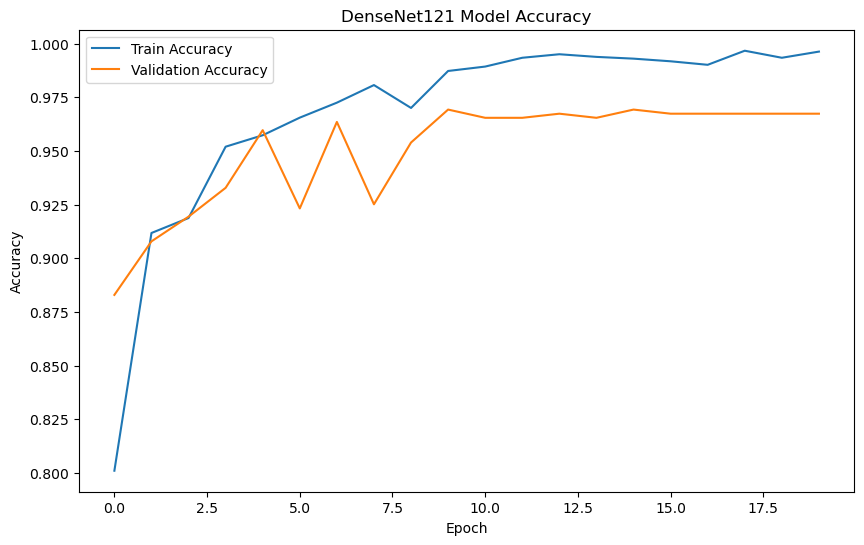

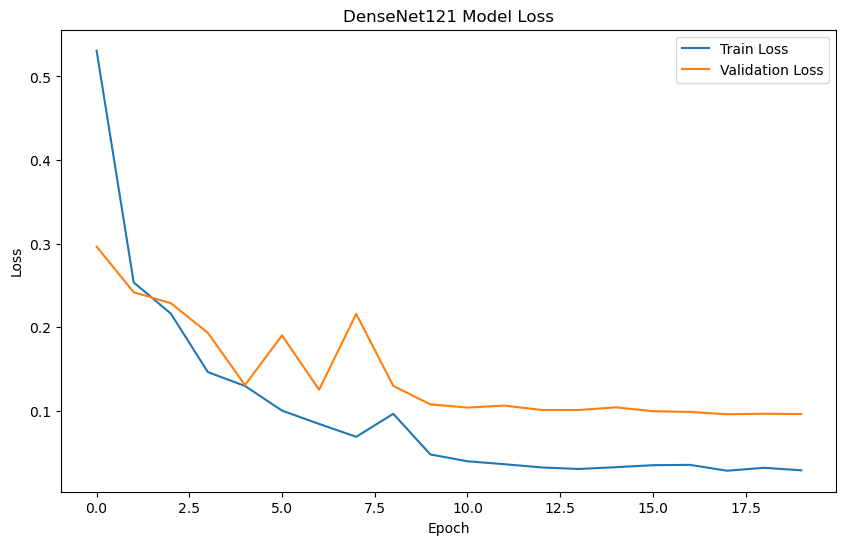

In [ ]:
import os
import math
from keras import backend as K
from keras.layers import Dense, GlobalAveragePooling2D, Dropout
from keras.applications import DenseNet121
from keras.applications.densenet import preprocess_input
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.models import Model
from keras.optimizers import Adam
from keras.callbacks import ReduceLROnPlateau, ModelCheckpoint
import matplotlib.pyplot as plt


# Define dataset paths
train_dir = "A:/tuberSplit/train"
val_dir = "A:/tuberSplit/val"

# Data augmentation and preprocessing
train_datagen = ImageDataGenerator(preprocessing_function=preprocess_input,
                                    zoom_range=0.1,
                                    horizontal_flip=True)
val_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

# Load training and validation data
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),
    color_mode='rgb',
    batch_size=32,
    class_mode='categorical',
    shuffle=True)

validation_generator = val_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    color_mode='rgb',
    batch_size=32,
    class_mode='categorical',
    shuffle=False)

# Clear previous sessions
K.clear_session()

# Learning rate reducer and checkpoint callback
lr_reduce = ReduceLROnPlateau(monitor='val_loss', factor=0.2,
                              patience=2, verbose=1, min_delta=0.0001)
filepath = "best_densenet121_weights.keras"  # Save best weights for DenseNet121
checkpoint = ModelCheckpoint(filepath, monitor='val_loss',
                             verbose=1, save_best_only=True, mode='min')

# Load DenseNet121 base model
base_model = DenseNet121(weights='imagenet', include_top=False)
x = base_model.output
x = GlobalAveragePooling2D()(x)
#x = Dropout(rate=0.5)(x)
x = Dense(256, activation='relu', kernel_initializer='he_normal')(x)
#x = Dropout(rate=0.5)(x)
preds = Dense(train_generator.num_classes, activation='softmax')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=preds)

# Freeze base model layers
for layer in base_model.layers:
    layer.trainable = False

# Compile the model
opt = Adam(learning_rate=0.001)
model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

# Model summary
model.summary()

# Correct step size calculation
step_size_train = math.ceil(train_generator.n / train_generator.batch_size)
step_size_val = math.ceil(validation_generator.n / validation_generator.batch_size)


history = model.fit(train_generator,
                    validation_data=validation_generator,
                    steps_per_epoch=step_size_train,
                    validation_steps=step_size_val,
                    epochs=20,
                    callbacks=[lr_reduce, checkpoint])

# Plot training history
plt.figure(figsize=(10, 6))
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('DenseNet121 Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('DenseNet121 Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()


x_test shape: (527, 224, 224, 3)
y_test_true shape: (527,)
17/17 ━━━━━━━━━━━━━━━━━━━━ 29s 1s/step
Model Accuracy: 97.72%

Classification Report:
                            precision    recall  f1-score   support

Blackspot Bruising Disease       0.96      0.97      0.97       113
            Healthy Potato       1.00      1.00      1.00       118
  Potato Brown Rot Disease       0.94      1.00      0.97        16
    Potato Dry Rot Disease       0.99      0.97      0.98       197
   Potato Soft Rot Disease       0.94      0.96      0.95        83

                  accuracy                           0.98       527
                 macro avg       0.97      0.98      0.97       527
              weighted avg       0.98      0.98      0.98       527

F1 Score: 0.98
F2 Score: 0.98


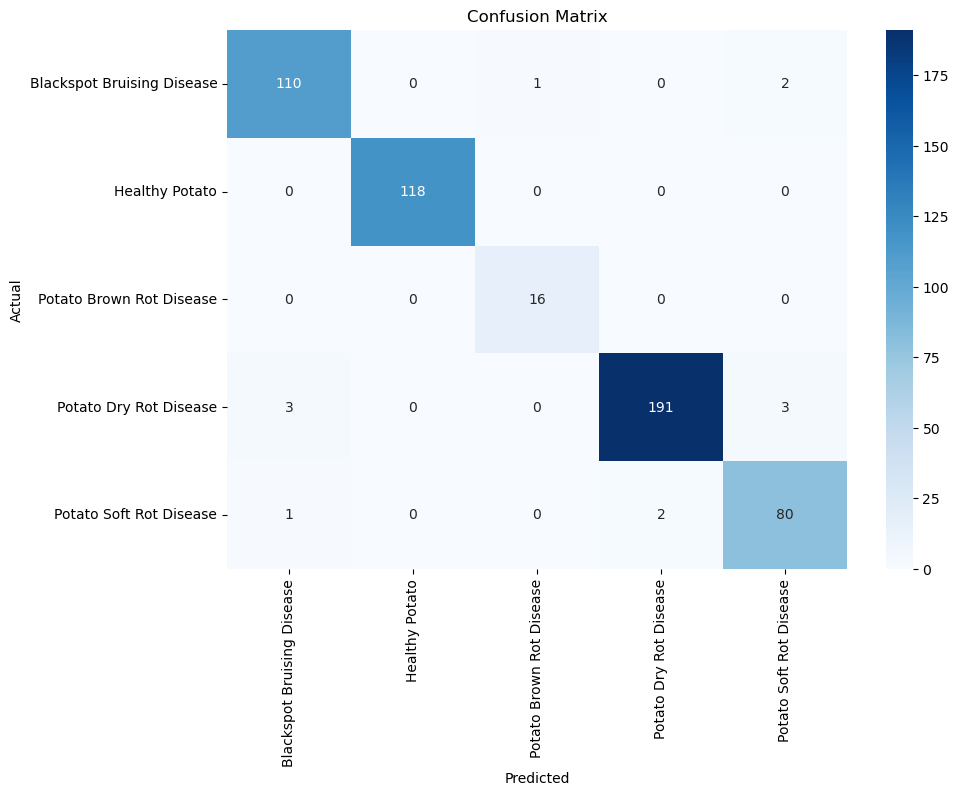

Recall: 0.98
Precision: 0.97


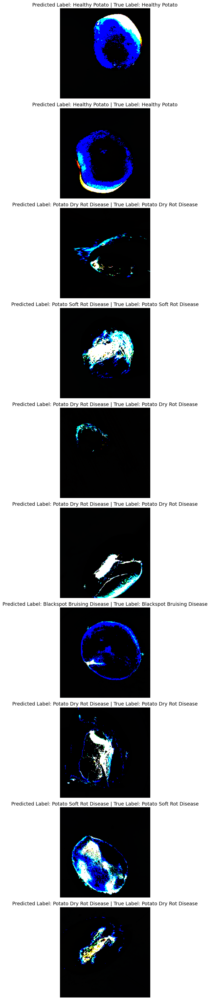

In [ ]:
import random
from keras.preprocessing import image
from sklearn.metrics import classification_report, f1_score
from keras.applications.densenet import preprocess_input
from sklearn.metrics import confusion_matrix
import numpy as np
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns

# Function to preprocess the image
def proc_img(img_path):
    """
    Process the image: Load, resize, and preprocess.
    """
    img = image.load_img(img_path, target_size=(224, 224))
    x_img = image.img_to_array(img)
    x_img = np.expand_dims(x_img, axis=0)
    x_img = preprocess_input(x_img)  # DenseNet121 preprocessing
    return x_img

# Define the test dataset path
test_path = Path("A:/tuberSplit/test")

# Automatically detect subdirectories as classes
classes = sorted([d.name for d in test_path.iterdir() if d.is_dir()])

# Get all images and their labels based on class indices
test_data = []
for class_index, class_name in enumerate(classes):
    class_dir = test_path / class_name
    for img in class_dir.glob('*.*'):  # Adjust extension filter if needed
        test_data.append((img, class_index))

# Create a DataFrame and shuffle
test_data = pd.DataFrame(test_data, columns=['image', 'label'])
test_data = test_data.sample(frac=1).reset_index(drop=True)

# Prepare x_test and y_test
num_samples = len(test_data)
x_test = np.zeros((num_samples, 224, 224, 3), dtype=np.float32)
y_test_true = np.array(test_data['label'], dtype=np.int32)

# Process images
for i, img_path in enumerate(test_data['image']):
    x_test[i] = proc_img(str(img_path))

# Debugging checks before prediction
print(f"x_test shape: {x_test.shape}")
print(f"y_test_true shape: {y_test_true.shape}")

# Predict the labels
y_test_pred = np.argmax(model.predict(x_test, verbose=1), axis=1)

# Calculate and print accuracy
accuracy = np.mean(y_test_pred == y_test_true)
print(f"Model Accuracy: {accuracy * 100:.2f}%")

# Classification Report
print("\nClassification Report:")
print(classification_report(y_test_true, y_test_pred, target_names=classes))

# F1 and F2 Scores
f1 = f1_score(y_test_true, y_test_pred, average='weighted')
print(f"F1 Score: {f1:.2f}")

# F2 Score (using beta=2)
def fbeta_score(y_true, y_pred, beta=2):
    """
    Compute F-beta score.
    """
    cm = confusion_matrix(y_true, y_pred)
    tp = np.diag(cm)
    fp = cm.sum(axis=0) - tp
    fn = cm.sum(axis=1) - tp
    precision = tp / (tp + fp + 1e-10)
    recall = tp / (tp + fn + 1e-10)
    beta_squared = beta ** 2
    fbeta = np.mean((1 + beta_squared) * (precision * recall) / (beta_squared * precision + recall + 1e-10))
    return fbeta

f2 = fbeta_score(y_test_true, y_test_pred, beta=2)
print(f"F2 Score: {f2:.2f}")

# Confusion Matrix
cm = confusion_matrix(y_test_true, y_test_pred)

# Plot confusion matrix using seaborn
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=classes, yticklabels=classes)
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.show()

# Metrics Calculation
def recall(y_true, y_pred):
    """
    Compute recall from confusion matrix.
    """
    cm = confusion_matrix(y_true, y_pred)
    tp = np.diag(cm)
    fn = cm.sum(axis=1) - tp
    return np.mean(tp / (tp + fn + 1e-10))

def precision(y_true, y_pred):
    """
    Compute precision from confusion matrix.
    """
    cm = confusion_matrix(y_true, y_pred)
    tp = np.diag(cm)
    fp = cm.sum(axis=0) - tp
    return np.mean(tp / (tp + fp + 1e-10))

# Print metrics
recall_value = recall(y_test_true, y_test_pred)
precision_value = precision(y_test_true, y_test_pred)
print(f"Recall: {recall_value:.2f}")
print(f"Precision: {precision_value:.2f}")

# Show 10 images with predicted and true labels
plt.figure(figsize=(20, 40))

random_indices = random.sample(range(len(x_test)), 10)

for i, idx in enumerate(random_indices):
    plt.subplot(10, 1, i + 1)
    image_to_show = x_test[idx]

    # Convert image for display if required
    if np.max(image_to_show) <= 1.0:  # If normalized (0 to 1), scale up
        image_to_show = (image_to_show * 255).astype(np.uint8)

    # No need to convert BGR to RGB for DenseNet121 preprocessing
    plt.imshow(image_to_show.astype(np.uint8))

    # Predicted and true labels
    predicted_label = classes[y_test_pred[idx]]
    true_label = classes[y_test_true[idx]]
    plt.title(f"Predicted Label: {predicted_label} | True Label: {true_label}", fontsize=14, color="black")
    plt.axis('off')

plt.tight_layout()
plt.show()

C:\Users\Arian\anaconda3\Lib\site-packages\keras\src\models\functional.py:238: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['keras_tensor']]
Received: inputs=Tensor(shape=(1, 224, 224, 3))
  warnings.warn(msg)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step


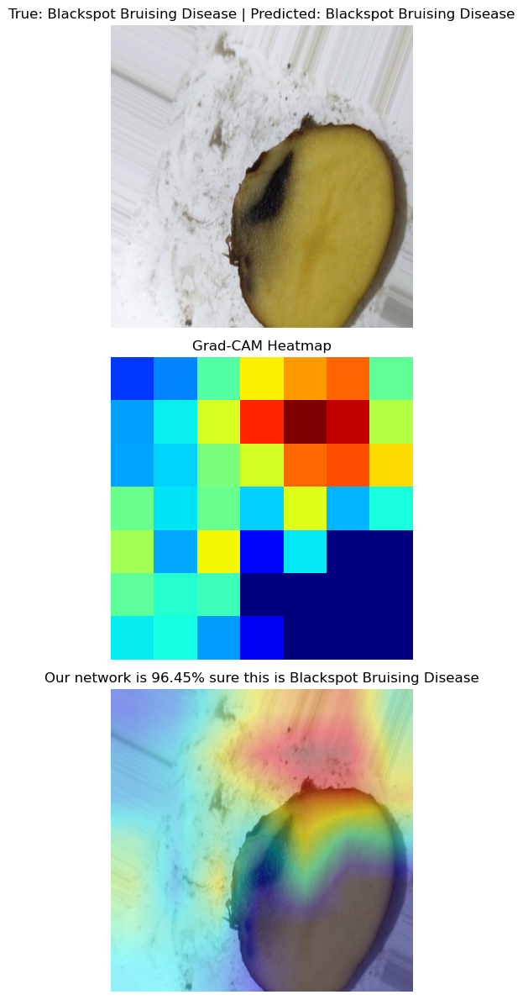

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 119ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step


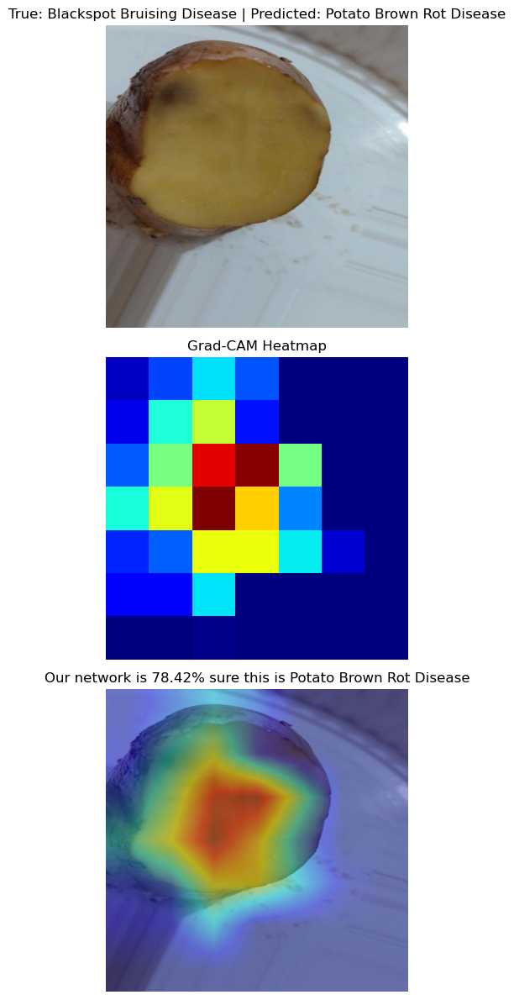

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


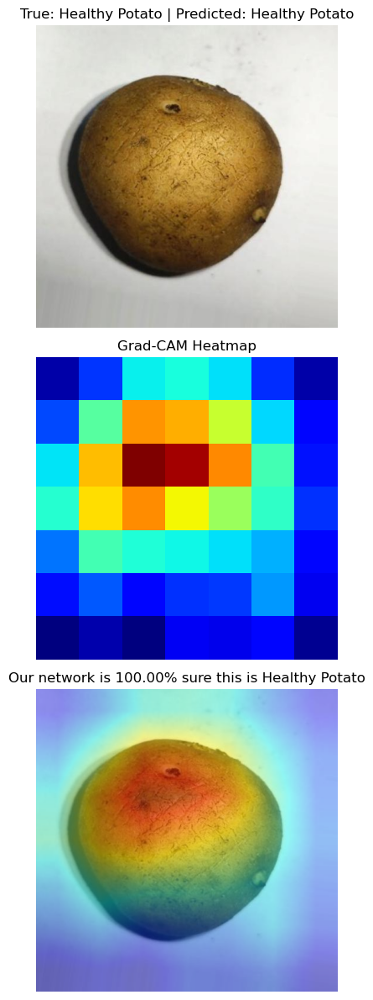

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 105ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


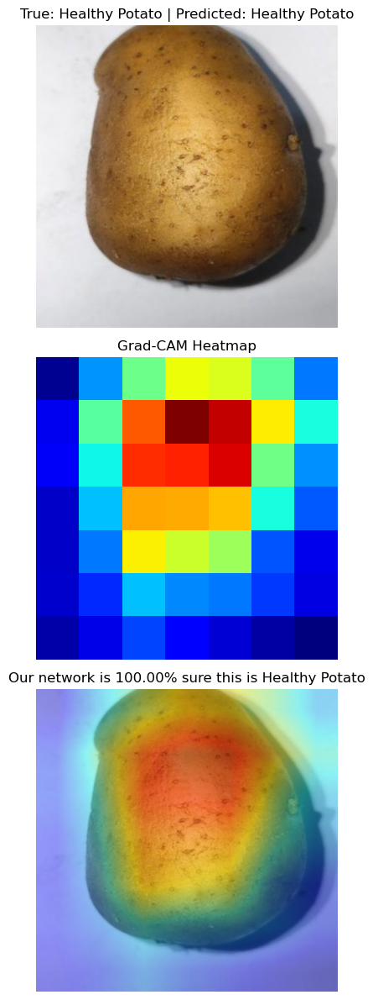

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 103ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 104ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


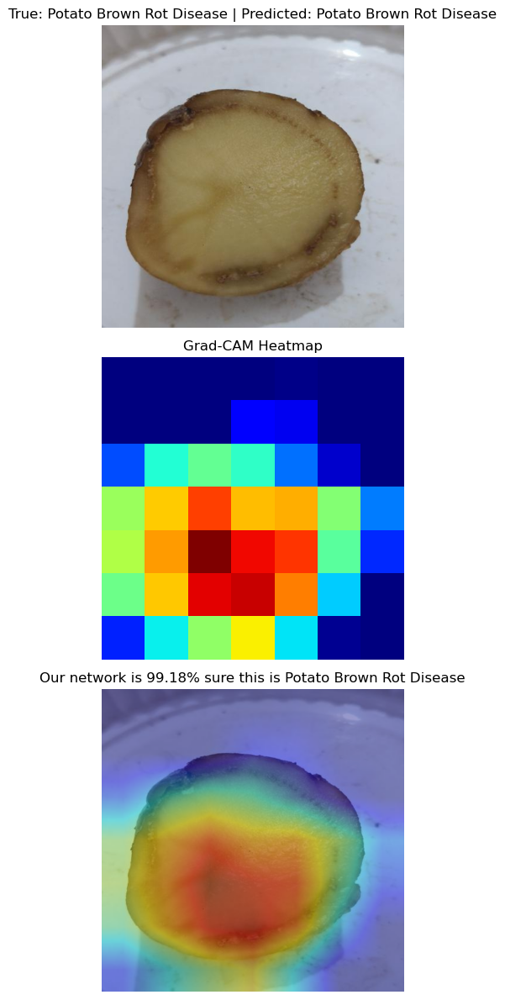

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 113ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


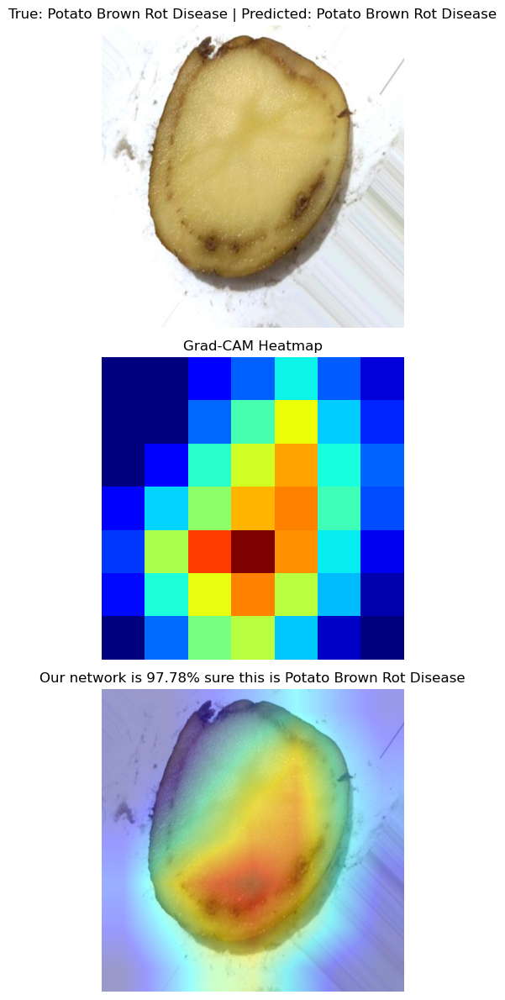

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 112ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 111ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step


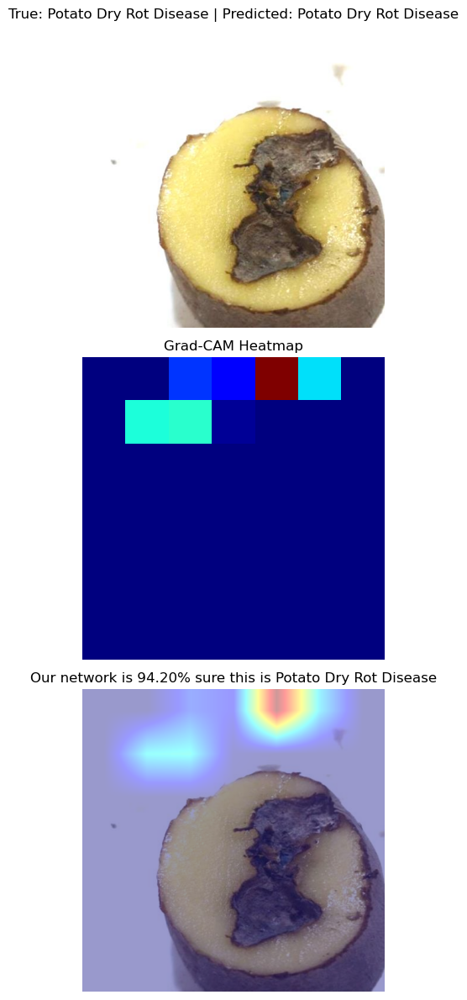

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 108ms/step


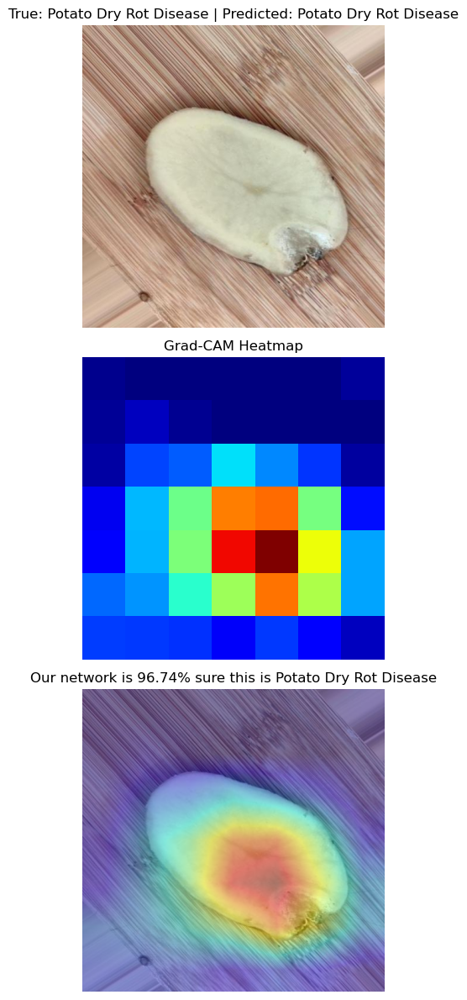

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 110ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step


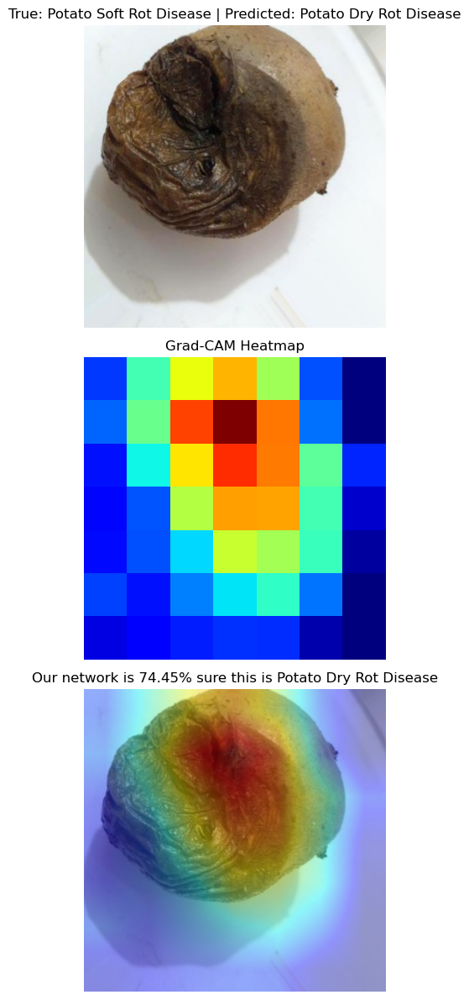

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


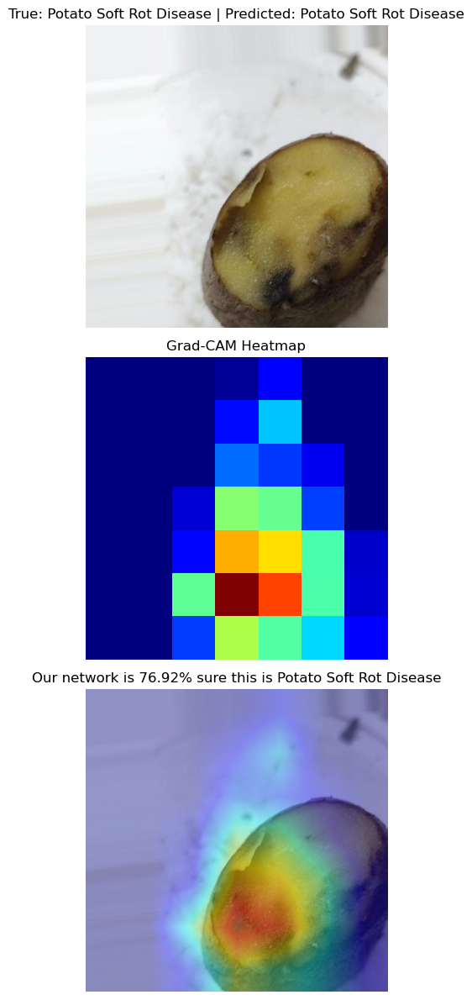

In [ ]:
import cv2
import random
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model
from tensorflow.keras import backend as K
from pathlib import Path
import tensorflow as tf
from tensorflow.keras.preprocessing import image
from keras.applications.densenet import preprocess_input

# Define Grad-CAM functions
def generate_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    """
    Generate Grad-CAM heatmap for a given image and model.
    """
    # Create a model that maps the input image to the activations of the last conv layer and the predictions
    grad_model = Model([model.inputs], [model.get_layer(last_conv_layer_name).output, model.output])

    with tf.GradientTape() as tape:
        # Forward pass
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = np.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    # Compute gradients of the class output value with respect to the feature map
    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = K.mean(grads, axis=(0, 1, 2))

    # Compute the weighted sum of feature maps
    conv_outputs = conv_outputs[0]
    heatmap = np.dot(conv_outputs, pooled_grads[..., np.newaxis])
    heatmap = np.squeeze(heatmap)

    # Normalize heatmap between 0 and 1
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap) + 1e-10
    return heatmap

def superimpose_gradcam(img_path, heatmap, intensity=0.4):
    """
    Overlay the Grad-CAM heatmap on the original image.
    """
    img = cv2.imread(img_path)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed_img = cv2.addWeighted(heatmap, intensity, img, 1 - intensity, 0)
    return cv2.cvtColor(superimposed_img, cv2.COLOR_BGR2RGB)

# Define classes for visualization
class_labels = ['Blackspot Bruising Disease','Healthy Potato','Potato Brown Rot Disease','Potato Dry Rot Disease','Potato Soft Rot Disease',]
last_conv_layer_name = 'conv5_block16_2_conv'  # DenseNet121's last convolutional layer (adjust if necessary)

# Randomly select 2 images per class for visualization
random_images = []
for class_index, class_name in enumerate(class_labels):
    class_dir = Path(f"A:/tuberSplit/test/{class_name}")
    all_images = list(class_dir.glob('*.*'))  # Adjust file extensions as needed
    selected_images = random.sample(all_images, 2)
    random_images.extend([(str(img_path), class_index) for img_path in selected_images])

# Preprocess the image (for DenseNet121)
def proc_img(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = preprocess_input(img_array)  # DenseNet121 specific preprocessing
    return img_array

# Create a new figure for each image
for i, (img_path, true_label) in enumerate(random_images):
    # Preprocess the image
    img_array = proc_img(img_path)

    # Generate Grad-CAM heatmap
    heatmap = generate_gradcam_heatmap(img_array, model, last_conv_layer_name)

    # Superimpose heatmap on the original image
    gradcam_img = superimpose_gradcam(img_path, heatmap)

    # Display images in separate figures
    fig, axes = plt.subplots(3, 1, figsize=(8, 12))

    # Original image
    axes[0].imshow(cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB))
    axes[0].set_title(f"True: {class_labels[true_label]} | Predicted: {class_labels[np.argmax(model.predict(img_array))]}")
    axes[0].axis('off')

    # Heatmap (mask)
    axes[1].imshow(heatmap, cmap='jet')
    axes[1].set_title("Grad-CAM Heatmap")
    axes[1].axis('off')

    # Grad-CAM superimposed image
    axes[2].imshow(gradcam_img)
    confidence = np.max(model.predict(img_array)) * 100
    predicted_label = class_labels[np.argmax(model.predict(img_array))]
    axes[2].set_title(f"Our network is {confidence:.2f}% sure this is {predicted_label}")
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()


In [ ]:
# Xception

Found 2437 images belonging to 5 classes.
Found 521 images belonging to 5 classes.



Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, None,      │          0 │ -                 │
│ (InputLayer)        │ None, 3)          │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1        │ (None, None,      │        864 │ input_layer[0][0] │
│ (Conv2D)            │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1_bn     │ (None, None,      │        128 │ block1_conv1[0][… │
│ (BatchNormalizatio… │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv1_act    │ (None, None,      │          0 │ block1_conv1_bn[… │
│ (Activation)        │ None, 32)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2        │ (None, None,      │     18,432 │ block1_conv1_act… │
│ (Conv2D)            │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2_bn     │ (None, None,      │        256 │ block1_conv2[0][… │
│ (BatchNormalizatio… │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1_conv2_act    │ (None, None,      │          0 │ block1_conv2_bn[… │
│ (Activation)        │ None, 64)         │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv1     │ (None, None,      │      8,768 │ block1_conv2_act… │
│ (SeparableConv2D)   │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv1_bn  │ (None, None,      │        512 │ block2_sepconv1[… │
│ (BatchNormalizatio… │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2_act │ (None, None,      │          0 │ block2_sepconv1_… │
│ (Activation)        │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2     │ (None, None,      │     17,536 │ block2_sepconv2_… │
│ (SeparableConv2D)   │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_sepconv2_bn  │ (None, None,      │        512 │ block2_sepconv2[… │
│ (BatchNormalizatio… │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, None,      │      8,192 │ block1_conv2_act… │
│                     │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block2_pool         │ (None, None,      │          0 │ block2_sepconv2_… │
│ (MaxPooling2D)      │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, None,      │        512 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ None, 128)        │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, None,      │          0 │ block2_pool[0][0… │
│                     │ None, 128)        │            │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block3_sepconv1_act │ (None, None,      │          0 │ add[0][0]       

 Total params: 21,387,309 (81.59 MB)

 Trainable params: 525,829 (2.01 MB)

 Non-trainable params: 20,861,480 (79.58 MB)

C:\Users\Arian\anaconda3\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.7309 - loss: 0.7224

C:\Users\Arian\anaconda3\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()



Epoch 1: val_loss improved from inf to 0.22906, saving model to best_xception_weights.keras
77/77 ━━━━━━━━━━━━━━━━━━━━ 225s 3s/step - accuracy: 0.7321 - loss: 0.7192 - val_accuracy: 0.9155 - val_loss: 0.2291 - learning_rate: 0.0010
Epoch 2/10
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9325 - loss: 0.1991
Epoch 2: val_loss improved from 0.22906 to 0.14487, saving model to best_xception_weights.keras
77/77 ━━━━━━━━━━━━━━━━━━━━ 208s 3s/step - accuracy: 0.9326 - loss: 0.1989 - val_accuracy: 0.9443 - val_loss: 0.1449 - learning_rate: 0.0010
Epoch 3/10
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9584 - loss: 0.1402
Epoch 3: val_loss did not improve from 0.14487
77/77 ━━━━━━━━━━━━━━━━━━━━ 206s 3s/step - accuracy: 0.9584 - loss: 0.1400 - val_accuracy: 0.9405 - val_loss: 0.1640 - learning_rate: 0.0010
Epoch 4/10
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9669 - loss: 0.1043
Epoch 4: val_loss improved from 0.14487 to 0.09881, saving model to best_xception_weights.keras

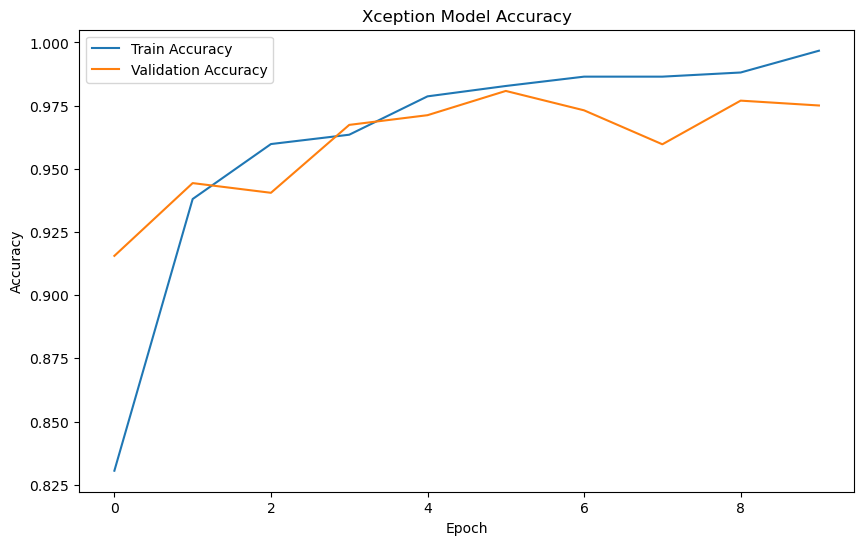

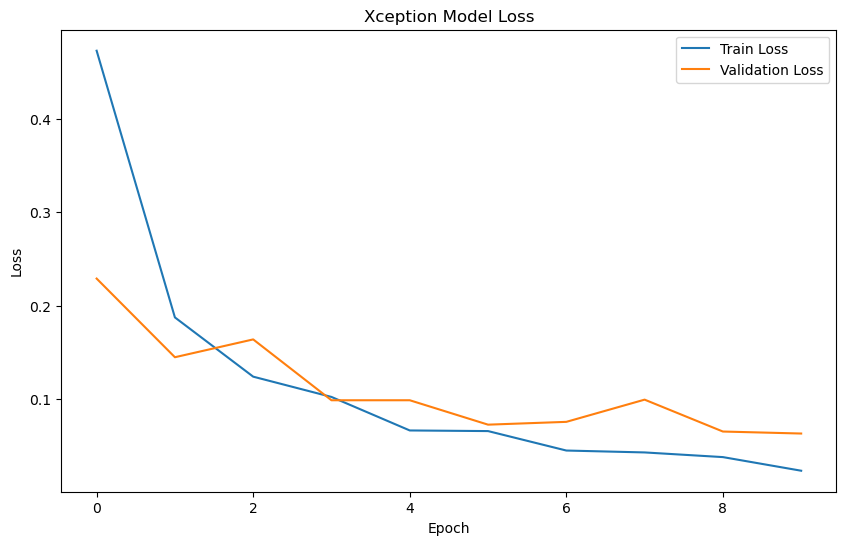

In [ ]:
import os
import math
from keras import backend as K
from keras.layers import Dense, GlobalAveragePooling2D, Dropout
from keras.applications import Xception
from keras.applications.xception import preprocess_input
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.models import Model
from keras.optimizers import Adam
from keras.callbacks import ReduceLROnPlateau, ModelCheckpoint
import matplotlib.pyplot as plt

# Define dataset paths
train_dir = "A:/tuberSplit/train"
val_dir = "A:/tuberSplit/val"

# Data augmentation and preprocessing
train_datagen = ImageDataGenerator(preprocessing_function=preprocess_input,
                                    zoom_range=0.1,
                                    horizontal_flip=True)
val_datagen = ImageDataGenerator(preprocessing_function=preprocess_input)

# Load training and validation data
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(299, 299),  # Xception requires 299x299 input size
    color_mode='rgb',
    batch_size=32,
    class_mode='categorical',
    shuffle=True)

validation_generator = val_datagen.flow_from_directory(
    val_dir,
    target_size=(299, 299),
    color_mode='rgb',
    batch_size=32,
    class_mode='categorical',
    shuffle=False)

# Clear previous sessions
K.clear_session()

# Learning rate reducer and checkpoint callback
lr_reduce = ReduceLROnPlateau(monitor='val_loss', factor=0.2,
                              patience=2, verbose=1, min_delta=0.0001)
filepath = "best_xception_weights.keras"  # Save best weights for Xception
checkpoint = ModelCheckpoint(filepath, monitor='val_loss',
                             verbose=1, save_best_only=True, mode='min')

# Load Xception base model
base_model = Xception(weights='imagenet', include_top=False)
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(256, activation='relu', kernel_initializer='he_normal')(x)
preds = Dense(train_generator.num_classes, activation='softmax')(x)

# Create the model
model = Model(inputs=base_model.input, outputs=preds)

# Freeze base model layers
for layer in base_model.layers:
    layer.trainable = False

# Compile the model
opt = Adam(learning_rate=0.001)
model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

# Model summary
model.summary()

# Correct step size calculation
step_size_train = math.ceil(train_generator.n / train_generator.batch_size)
step_size_val = math.ceil(validation_generator.n / validation_generator.batch_size)

# Train the model
history = model.fit(train_generator,
                    validation_data=validation_generator,
                    steps_per_epoch=step_size_train,
                    validation_steps=step_size_val,
                    epochs=10,
                    callbacks=[lr_reduce, checkpoint])

# Plot training history
plt.figure(figsize=(10, 6))
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('Xception Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('Xception Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()


x_test shape: (527, 299, 299, 3)
y_test_true shape: (527,)
17/17 ━━━━━━━━━━━━━━━━━━━━ 37s 2s/step
Model Accuracy: 97.53%

Classification Report:
                            precision    recall  f1-score   support

Blackspot Bruising Disease       0.93      0.99      0.96       113
            Healthy Potato       1.00      1.00      1.00       118
  Potato Brown Rot Disease       1.00      1.00      1.00        16
    Potato Dry Rot Disease       0.99      0.96      0.98       197
   Potato Soft Rot Disease       0.96      0.95      0.96        83

                  accuracy                           0.98       527
                 macro avg       0.98      0.98      0.98       527
              weighted avg       0.98      0.98      0.98       527

F1 Score: 0.98
F2 Score: 0.98


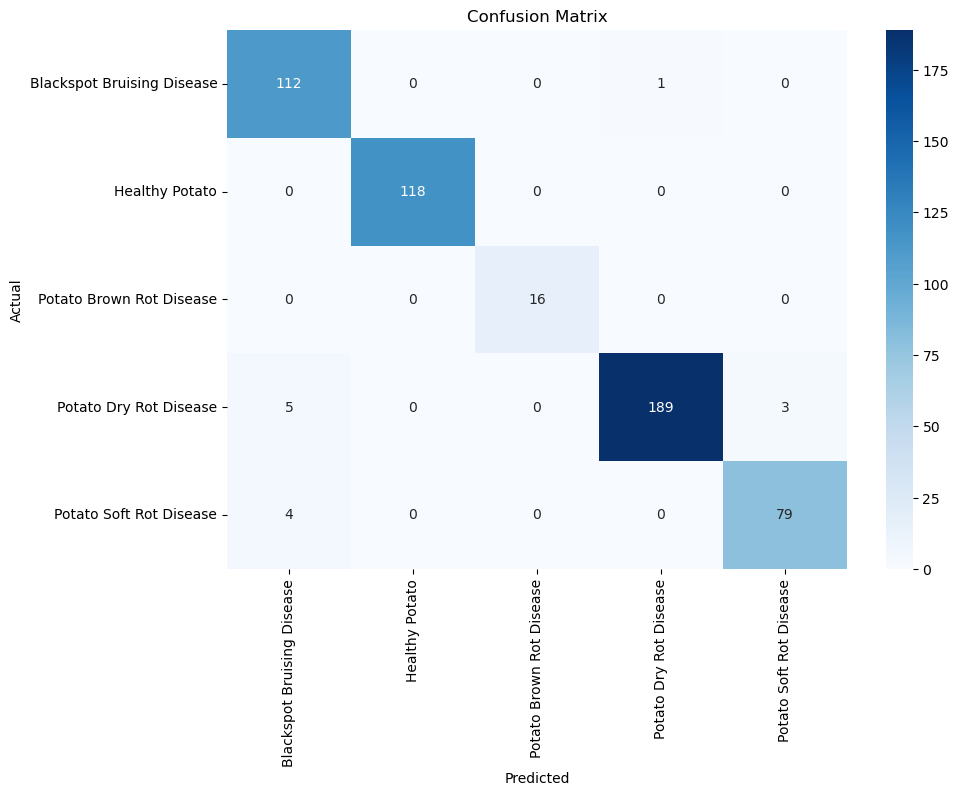

Recall: 0.98
Precision: 0.98


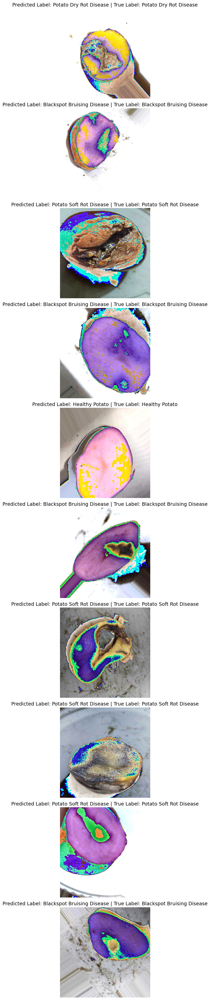

In [ ]:
import random
from keras.preprocessing import image
from sklearn.metrics import classification_report, f1_score
from keras.applications.xception import preprocess_input
from sklearn.metrics import confusion_matrix
import numpy as np
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns

# Function to preprocess the image
def proc_img(img_path):
    """
    Process the image: Load, resize, and preprocess.
    """
    img = image.load_img(img_path, target_size=(299, 299))
    x_img = image.img_to_array(img)
    x_img = np.expand_dims(x_img, axis=0)
    x_img = preprocess_input(x_img)  # Xception preprocessing
    return x_img

# Define the test dataset path
test_path = Path("A:/tuberSplit/test")

# Automatically detect subdirectories as classes
classes = sorted([d.name for d in test_path.iterdir() if d.is_dir()])

# Get all images and their labels based on class indices
test_data = []
for class_index, class_name in enumerate(classes):
    class_dir = test_path / class_name
    for img in class_dir.glob('*.*'):  # Adjust extension filter if needed
        test_data.append((img, class_index))

# Create a DataFrame and shuffle
test_data = pd.DataFrame(test_data, columns=['image', 'label'])
test_data = test_data.sample(frac=1).reset_index(drop=True)

# Prepare x_test and y_test
num_samples = len(test_data)
x_test = np.zeros((num_samples, 299, 299, 3), dtype=np.float32)
y_test_true = np.array(test_data['label'], dtype=np.int32)

# Process images
for i, img_path in enumerate(test_data['image']):
    x_test[i] = proc_img(str(img_path))

# Debugging checks before prediction
print(f"x_test shape: {x_test.shape}")
print(f"y_test_true shape: {y_test_true.shape}")

# Predict the labels
y_test_pred = np.argmax(model.predict(x_test, verbose=1), axis=1)

# Calculate and print accuracy
accuracy = np.mean(y_test_pred == y_test_true)
print(f"Model Accuracy: {accuracy * 100:.2f}%")

# Classification Report
print("\nClassification Report:")
print(classification_report(y_test_true, y_test_pred, target_names=classes))

# F1 and F2 Scores
f1 = f1_score(y_test_true, y_test_pred, average='weighted')
print(f"F1 Score: {f1:.2f}")

# F2 Score (using beta=2)
def fbeta_score(y_true, y_pred, beta=2):
    """
    Compute F-beta score.
    """
    cm = confusion_matrix(y_true, y_pred)
    tp = np.diag(cm)
    fp = cm.sum(axis=0) - tp
    fn = cm.sum(axis=1) - tp
    precision = tp / (tp + fp + 1e-10)
    recall = tp / (tp + fn + 1e-10)
    beta_squared = beta ** 2
    fbeta = np.mean((1 + beta_squared) * (precision * recall) / (beta_squared * precision + recall + 1e-10))
    return fbeta

f2 = fbeta_score(y_test_true, y_test_pred, beta=2)
print(f"F2 Score: {f2:.2f}")

# Confusion Matrix
cm = confusion_matrix(y_test_true, y_test_pred)

# Plot confusion matrix using seaborn
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=classes, yticklabels=classes)
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.show()

# Metrics Calculation
def recall(y_true, y_pred):
    """
    Compute recall from confusion matrix.
    """
    cm = confusion_matrix(y_true, y_pred)
    tp = np.diag(cm)
    fn = cm.sum(axis=1) - tp
    return np.mean(tp / (tp + fn + 1e-10))

def precision(y_true, y_pred):
    """
    Compute precision from confusion matrix.
    """
    cm = confusion_matrix(y_true, y_pred)
    tp = np.diag(cm)
    fp = cm.sum(axis=0) - tp
    return np.mean(tp / (tp + fp + 1e-10))

# Print metrics
recall_value = recall(y_test_true, y_test_pred)
precision_value = precision(y_test_true, y_test_pred)
print(f"Recall: {recall_value:.2f}")
print(f"Precision: {precision_value:.2f}")

# Show 10 images with predicted and true labels
plt.figure(figsize=(20, 40))

random_indices = random.sample(range(len(x_test)), 10)

for i, idx in enumerate(random_indices):
    plt.subplot(10, 1, i + 1)
    image_to_show = x_test[idx]

    # Convert image for display if required
    if np.max(image_to_show) <= 1.0:  # If normalized (0 to 1), scale up
        image_to_show = (image_to_show * 255).astype(np.uint8)

    # No need to convert BGR to RGB for Xception preprocessing
    plt.imshow(image_to_show.astype(np.uint8))

    # Predicted and true labels
    predicted_label = classes[y_test_pred[idx]]
    true_label = classes[y_test_true[idx]]
    plt.title(f"Predicted Label: {predicted_label} | True Label: {true_label}", fontsize=14, color="black")
    plt.axis('off')

plt.tight_layout()
plt.show()



C:\Users\Arian\anaconda3\Lib\site-packages\keras\src\models\functional.py:238: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['keras_tensor']]
Received: inputs=Tensor(shape=(1, 299, 299, 3))
  warnings.warn(msg)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 125ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


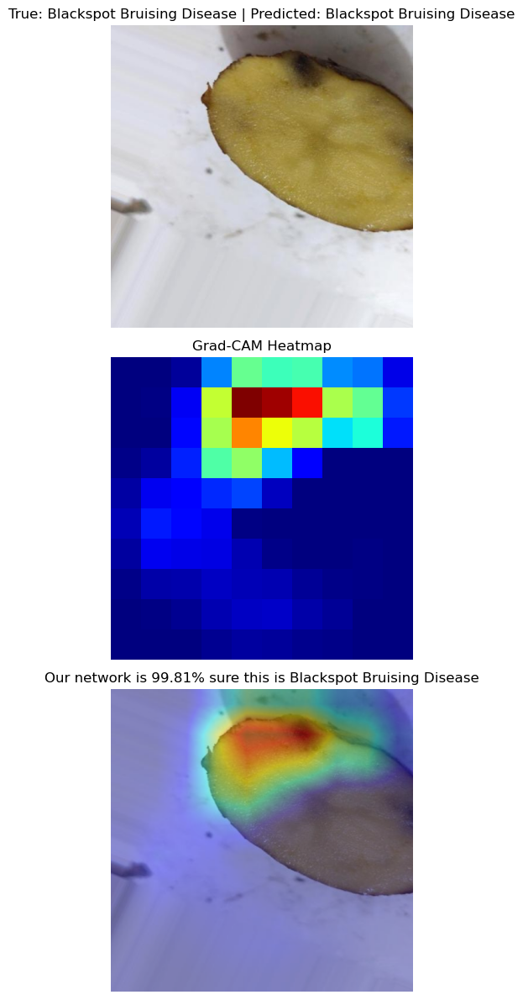

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


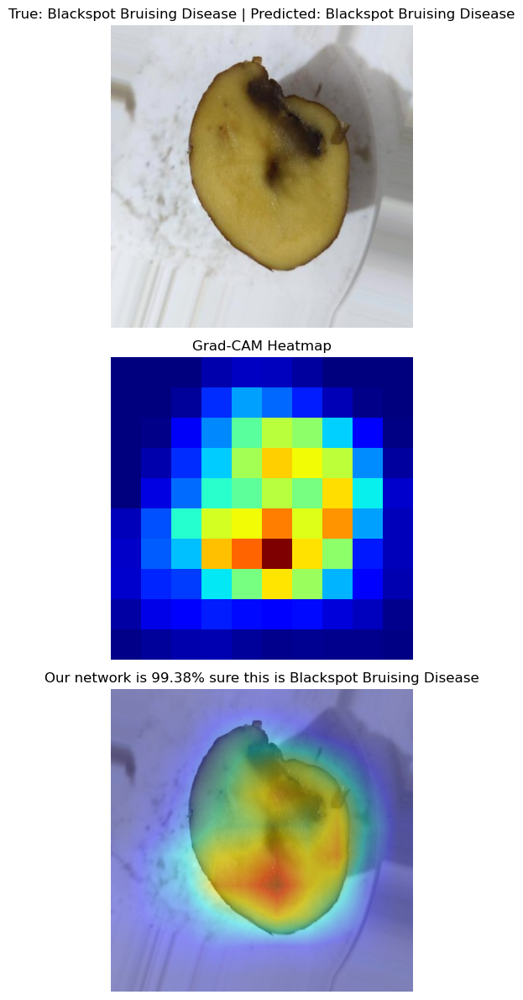

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


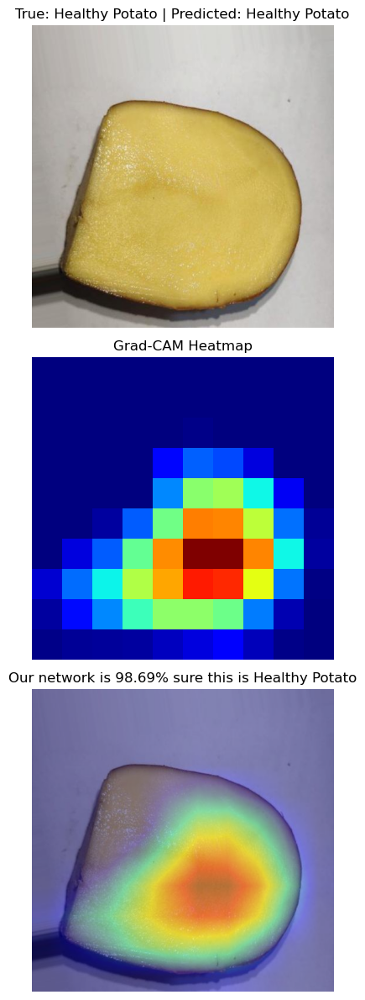

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 115ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 121ms/step


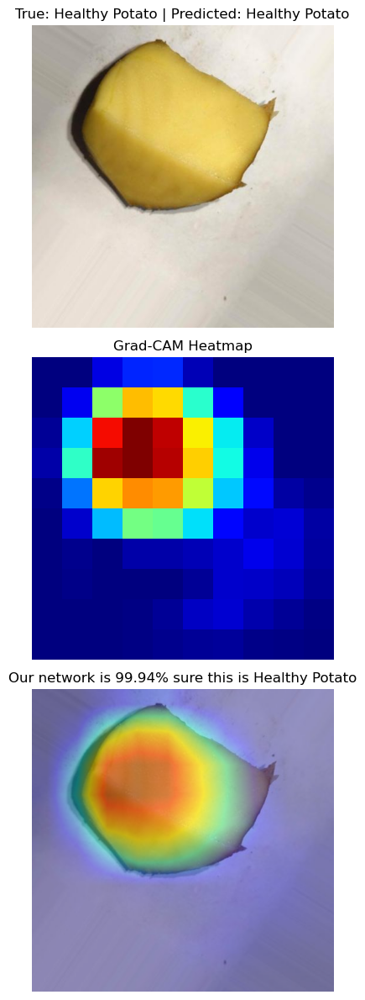

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 100ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 102ms/step


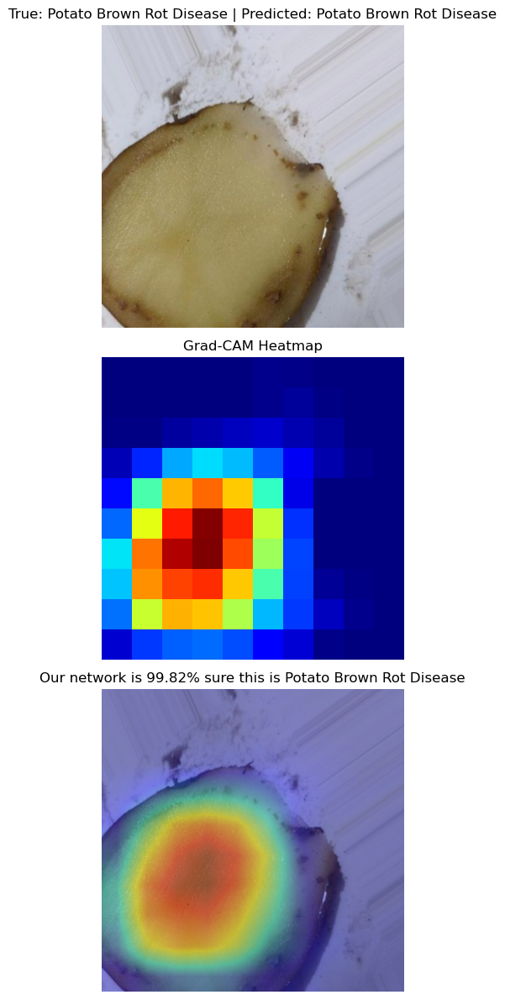

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 107ms/step


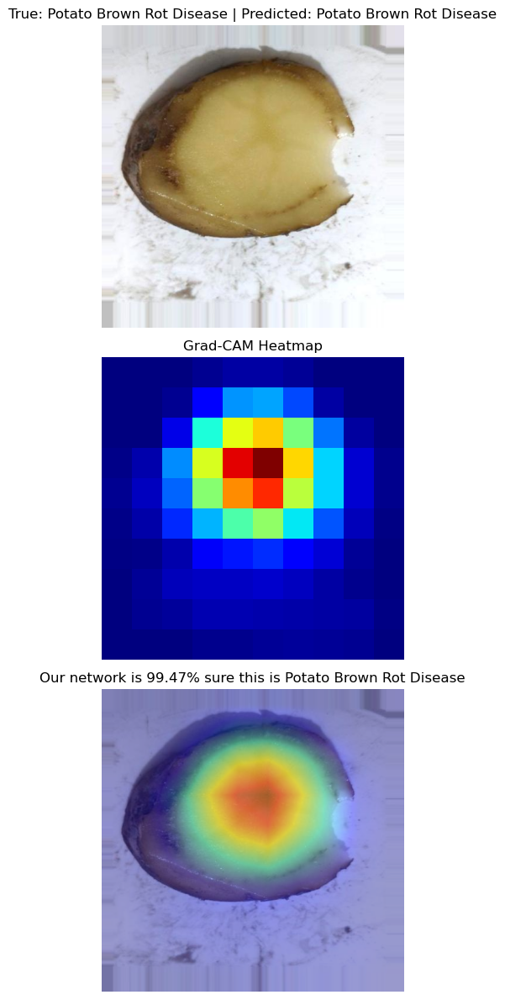

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


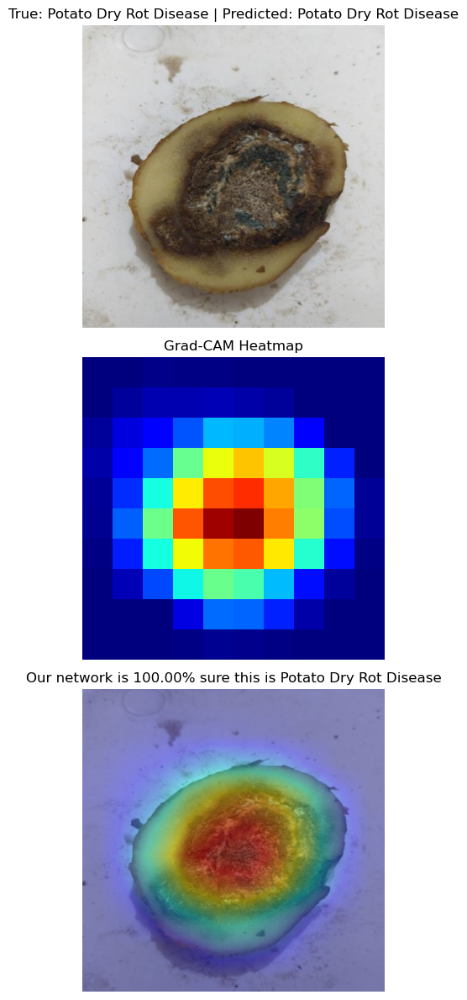

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


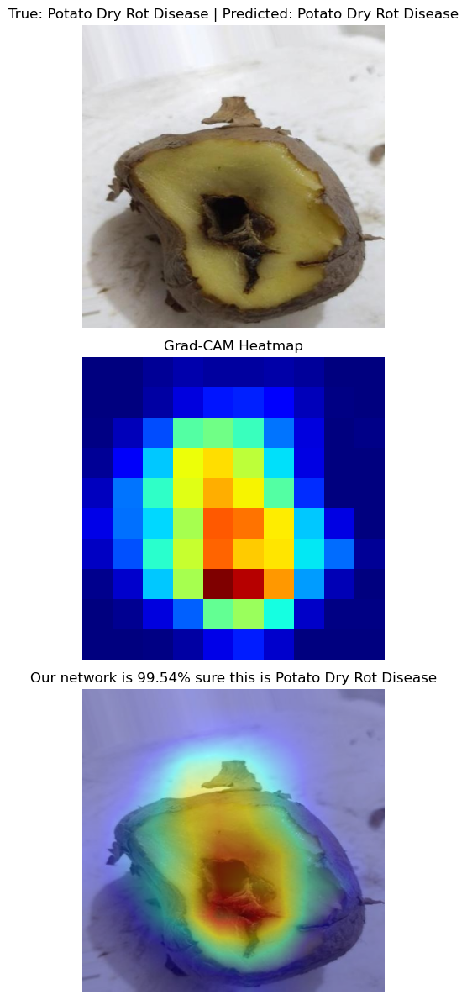

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


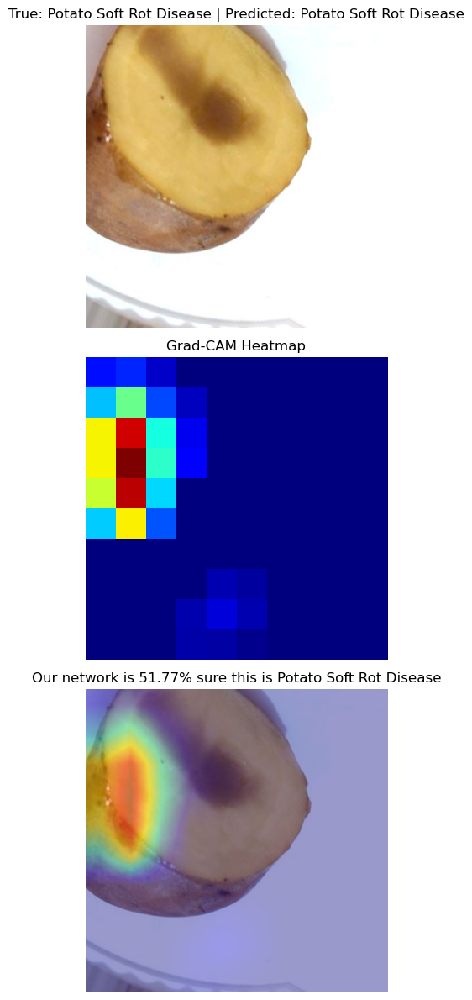

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


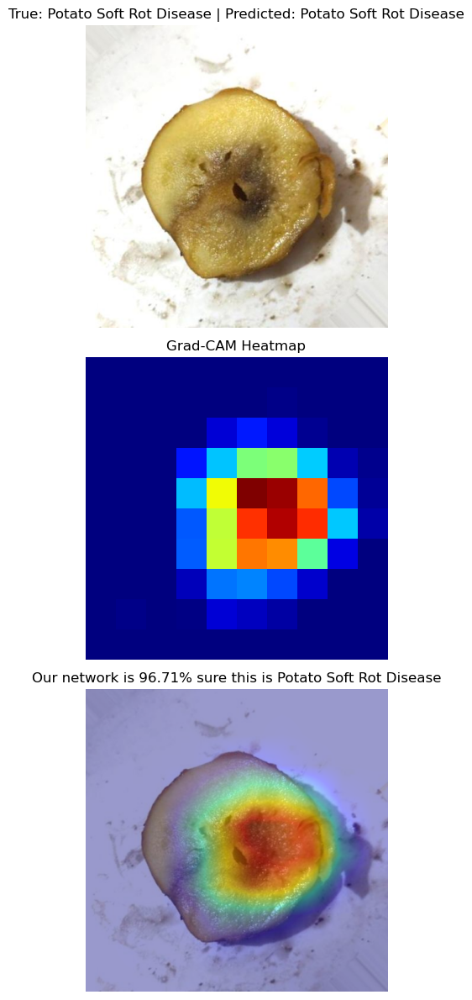

In [ ]:
import cv2
import random
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model
from tensorflow.keras import backend as K
from pathlib import Path
import tensorflow as tf
from tensorflow.keras.preprocessing import image
from tensorflow.keras.applications.xception import preprocess_input

# Define Grad-CAM functions
def generate_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    """
    Generate Grad-CAM heatmap for a given image and model.
    """
    # Create a model that maps the input image to the activations of the last conv layer and the predictions
    grad_model = Model([model.inputs], [model.get_layer(last_conv_layer_name).output, model.output])

    with tf.GradientTape() as tape:
        # Forward pass
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = np.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    # Compute gradients of the class output value with respect to the feature map
    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = K.mean(grads, axis=(0, 1, 2))

    # Compute the weighted sum of feature maps
    conv_outputs = conv_outputs[0]
    heatmap = np.dot(conv_outputs, pooled_grads[..., np.newaxis])
    heatmap = np.squeeze(heatmap)

    # Normalize heatmap between 0 and 1
    heatmap = np.maximum(heatmap, 0)
    heatmap /= np.max(heatmap) + 1e-10
    return heatmap

def superimpose_gradcam(img_path, heatmap, intensity=0.4):
    """
    Overlay the Grad-CAM heatmap on the original image.
    """
    img = cv2.imread(img_path)
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)
    superimposed_img = cv2.addWeighted(heatmap, intensity, img, 1 - intensity, 0)
    return cv2.cvtColor(superimposed_img, cv2.COLOR_BGR2RGB)

# Define classes for visualization
class_labels = ['Blackspot Bruising Disease', 'Healthy Potato', 'Potato Brown Rot Disease', 'Potato Dry Rot Disease', 'Potato Soft Rot Disease']
last_conv_layer_name = 'block14_sepconv2_act'  # Xception's last convolutional layer (adjust if necessary)

# Randomly select 2 images per class for visualization
random_images = []
for class_index, class_name in enumerate(class_labels):
    class_dir = Path(f"A:/tuberSplit/test/{class_name}")
    all_images = list(class_dir.glob('*.*'))  # Adjust file extensions as needed
    selected_images = random.sample(all_images, 2)
    random_images.extend([(str(img_path), class_index) for img_path in selected_images])

# Preprocess the image (for Xception)
def proc_img(img_path):
    img = image.load_img(img_path, target_size=(299, 299))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = preprocess_input(img_array)  # Xception-specific preprocessing
    return img_array

# Create a new figure for each image
for i, (img_path, true_label) in enumerate(random_images):
    # Preprocess the image
    img_array = proc_img(img_path)

    # Generate Grad-CAM heatmap
    heatmap = generate_gradcam_heatmap(img_array, model, last_conv_layer_name)

    # Superimpose heatmap on the original image
    gradcam_img = superimpose_gradcam(img_path, heatmap)

    # Display images in separate figures
    fig, axes = plt.subplots(3, 1, figsize=(8, 12))

    # Original image
    axes[0].imshow(cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB))
    axes[0].set_title(f"True: {class_labels[true_label]} | Predicted: {class_labels[np.argmax(model.predict(img_array))]}")
    axes[0].axis('off')

    # Heatmap (mask)
    axes[1].imshow(heatmap, cmap='jet')
    axes[1].set_title("Grad-CAM Heatmap")
    axes[1].axis('off')

    # Grad-CAM superimposed image
    axes[2].imshow(gradcam_img)
    confidence = np.max(model.predict(img_array)) * 100
    predicted_label = class_labels[np.argmax(model.predict(img_array))]
    axes[2].set_title(f"Our network is {confidence:.2f}% sure this is {predicted_label}")
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()


In [ ]:
# NASNetMobile

Found 2437 images belonging to 5 classes.
Found 521 images belonging to 5 classes.
19993432/19993432 ━━━━━━━━━━━━━━━━━━━━ 18s 1us/step


C:\Users\Arian\anaconda3\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/10
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 1s/step - accuracy: 0.6179 - loss: 0.9449

C:\Users\Arian\anaconda3\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()



Epoch 1: val_loss improved from inf to 0.41850, saving model to best_nasnetmobile_weights.keras
77/77 ━━━━━━━━━━━━━━━━━━━━ 121s 1s/step - accuracy: 0.6194 - loss: 0.9414 - val_accuracy: 0.8349 - val_loss: 0.4185 - learning_rate: 0.0010
Epoch 2/10
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 842ms/step - accuracy: 0.8737 - loss: 0.3662
Epoch 2: val_loss improved from 0.41850 to 0.30475, saving model to best_nasnetmobile_weights.keras
77/77 ━━━━━━━━━━━━━━━━━━━━ 77s 998ms/step - accuracy: 0.8738 - loss: 0.3659 - val_accuracy: 0.8906 - val_loss: 0.3047 - learning_rate: 0.0010
Epoch 3/10
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 839ms/step - accuracy: 0.9048 - loss: 0.2832
Epoch 3: val_loss improved from 0.30475 to 0.25454, saving model to best_nasnetmobile_weights.keras
77/77 ━━━━━━━━━━━━━━━━━━━━ 77s 1s/step - accuracy: 0.9048 - loss: 0.2830 - val_accuracy: 0.9136 - val_loss: 0.2545 - learning_rate: 0.0010
Epoch 4/10
77/77 ━━━━━━━━━━━━━━━━━━━━ 0s 890ms/step - accuracy: 0.9126 - loss: 0.2202
Epoch 4: val_loss improv

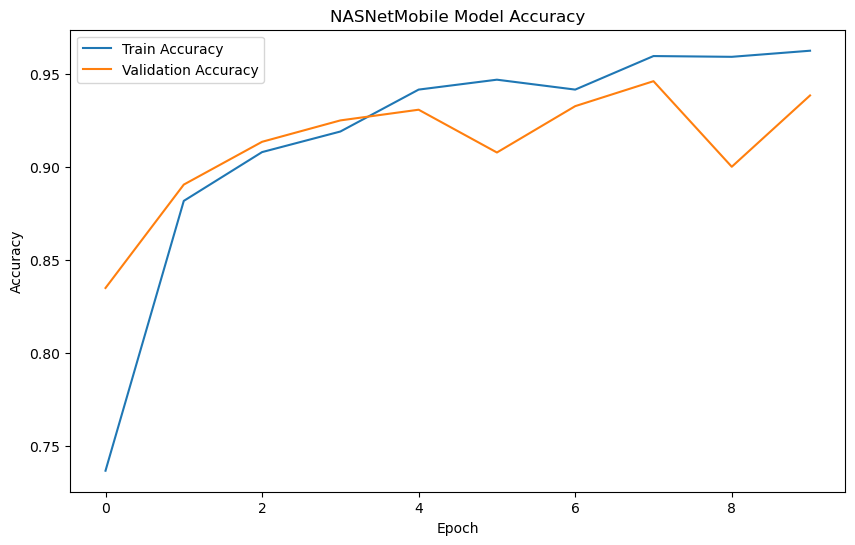

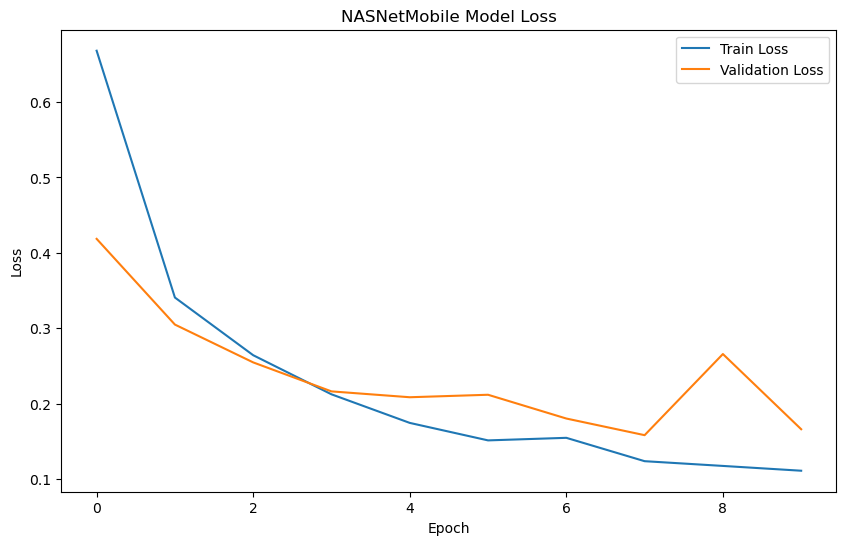

In [ ]:
from tensorflow.keras.applications import NASNetMobile
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint
import math
import matplotlib.pyplot as plt

# Dataset paths
train_dir = "A:/tuberSplit/train"
val_dir = "A:/tuberSplit/val"

# Data augmentation and preprocessing
train_datagen = ImageDataGenerator(rescale=1./255, zoom_range=0.1, horizontal_flip=True)
val_datagen = ImageDataGenerator(rescale=1./255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),
    color_mode='rgb',
    batch_size=32,  # Smaller batch size for memory efficiency
    class_mode='categorical',
    shuffle=True
)

validation_generator = val_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    color_mode='rgb',
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

# Load NASNetMobile with pretrained weights
base_model = NASNetMobile(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Freeze the base model layers
base_model.trainable = False

# Add custom layers on top
x = base_model.output
x = GlobalAveragePooling2D()(x)  # Pooling layer to reduce dimensionality
x = Dense(64, activation='relu', kernel_initializer='he_normal')(x)  # Reduced dense layer
predictions = Dense(train_generator.num_classes, activation='softmax')(x)

# Create the final model
model = Model(inputs=base_model.input, outputs=predictions)

# Compile the model
opt = Adam(learning_rate=0.001)
model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

# Callbacks
lr_reduce = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=2, verbose=1, min_delta=0.0001)
filepath = "best_nasnetmobile_weights.keras"
checkpoint = ModelCheckpoint(filepath, monitor='val_loss', verbose=1, save_best_only=True, mode='min')

# Train the model
history = model.fit(
    train_generator,
    validation_data=validation_generator,
    steps_per_epoch=math.ceil(train_generator.n / train_generator.batch_size),
    validation_steps=math.ceil(validation_generator.n / validation_generator.batch_size),
    epochs=10,
    callbacks=[lr_reduce, checkpoint]
)

# Plot training history
plt.figure(figsize=(10, 6))
plt.plot(history.history['accuracy'], label='Train Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.title('NASNetMobile Model Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

plt.figure(figsize=(10, 6))
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.title('NASNetMobile Model Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()



x_test shape: (527, 224, 224, 3)
y_test_true shape: (527,)
17/17 ━━━━━━━━━━━━━━━━━━━━ 19s 880ms/step
Model Accuracy: 87.10%

Classification Report:
                            precision    recall  f1-score   support

Blackspot Bruising Disease       0.97      0.68      0.80       113
            Healthy Potato       0.98      1.00      0.99       118
  Potato Brown Rot Disease       1.00      0.75      0.86        16
    Potato Dry Rot Disease       0.95      0.87      0.91       197
   Potato Soft Rot Disease       0.60      0.98      0.74        83

                  accuracy                           0.87       527
                 macro avg       0.90      0.86      0.86       527
              weighted avg       0.91      0.87      0.88       527

F1 Score: 0.88
F2 Score: 0.85


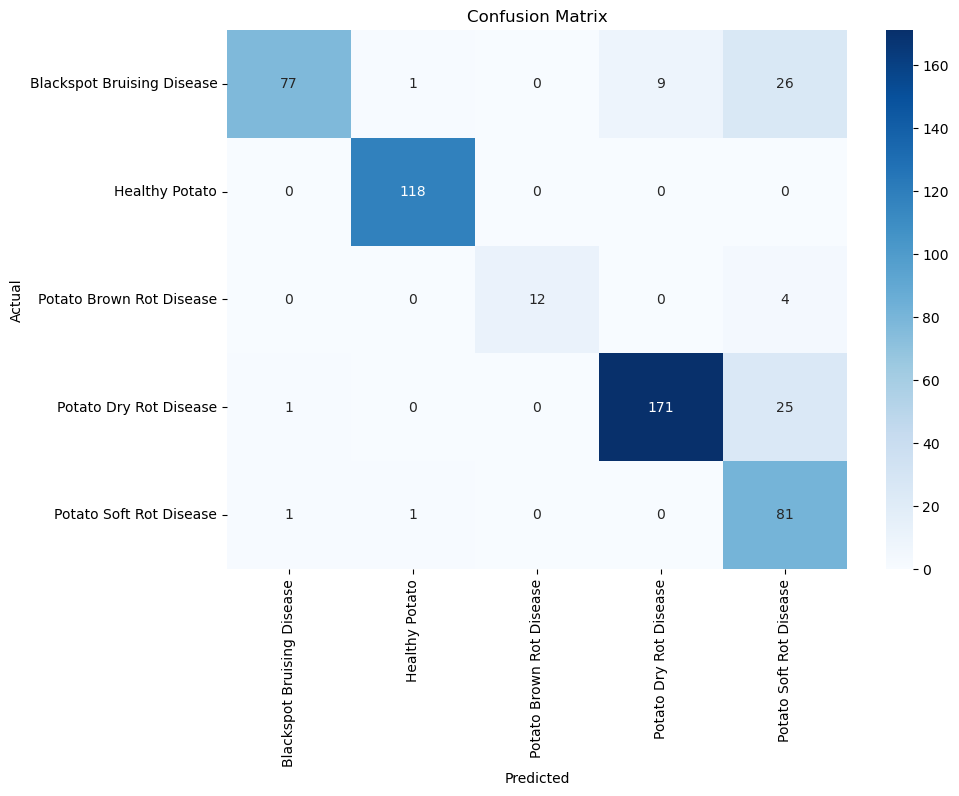

Recall: 0.86
Precision: 0.90


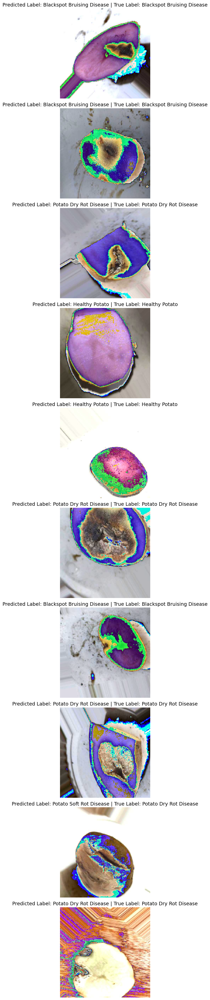

In [ ]:
import random
from keras.preprocessing import image
from sklearn.metrics import classification_report, f1_score, confusion_matrix
from keras.applications.nasnet import preprocess_input
import numpy as np
import pandas as pd
from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns

# Function to preprocess the image
def proc_img(img_path):
    """
    Process the image: Load, resize, and preprocess.
    """
    img = image.load_img(img_path, target_size=(224, 224))
    x_img = image.img_to_array(img)
    x_img = np.expand_dims(x_img, axis=0)
    x_img = preprocess_input(x_img)  # NASNetMobile preprocessing
    return x_img

# Define the test dataset path
test_path = Path("A:/tuberSplit/test")

# Automatically detect subdirectories as classes
classes = sorted([d.name for d in test_path.iterdir() if d.is_dir()])

# Get all images and their labels based on class indices
test_data = []
for class_index, class_name in enumerate(classes):
    class_dir = test_path / class_name
    for img in class_dir.glob('*.*'):  # Adjust extension filter if needed
        test_data.append((img, class_index))

# Create a DataFrame and shuffle
test_data = pd.DataFrame(test_data, columns=['image', 'label'])
test_data = test_data.sample(frac=1).reset_index(drop=True)

# Prepare x_test and y_test
num_samples = len(test_data)
x_test = np.zeros((num_samples, 224, 224, 3), dtype=np.float32)
y_test_true = np.array(test_data['label'], dtype=np.int32)

# Process images
for i, img_path in enumerate(test_data['image']):
    x_test[i] = proc_img(str(img_path))

# Debugging checks before prediction
print(f"x_test shape: {x_test.shape}")
print(f"y_test_true shape: {y_test_true.shape}")

# Predict the labels
batch_size = 32
y_test_pred = np.argmax(model.predict(x_test, batch_size=batch_size, verbose=1), axis=1)

# Calculate and print accuracy
accuracy = np.mean(y_test_pred == y_test_true)
print(f"Model Accuracy: {accuracy * 100:.2f}%")

# Classification Report
print("\nClassification Report:")
print(classification_report(y_test_true, y_test_pred, target_names=classes))

# F1 and F2 Scores
f1 = f1_score(y_test_true, y_test_pred, average='weighted')
print(f"F1 Score: {f1:.2f}")

# F2 Score (using beta=2)
def fbeta_score(y_true, y_pred, beta=2):
    """
    Compute F-beta score.
    """
    cm = confusion_matrix(y_true, y_pred)
    tp = np.diag(cm)
    fp = cm.sum(axis=0) - tp
    fn = cm.sum(axis=1) - tp
    precision = tp / (tp + fp + 1e-10)
    recall = tp / (tp + fn + 1e-10)
    beta_squared = beta ** 2
    fbeta = np.mean((1 + beta_squared) * (precision * recall) / (beta_squared * precision + recall + 1e-10))
    return fbeta

f2 = fbeta_score(y_test_true, y_test_pred, beta=2)
print(f"F2 Score: {f2:.2f}")

# Confusion Matrix
cm = confusion_matrix(y_test_true, y_test_pred)

# Plot confusion matrix using seaborn
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", xticklabels=classes, yticklabels=classes)
plt.xlabel("Predicted")
plt.ylabel("Actual")
plt.title("Confusion Matrix")
plt.show()

# Metrics Calculation
def recall(y_true, y_pred):
    """
    Compute recall from confusion matrix.
    """
    cm = confusion_matrix(y_true, y_pred)
    tp = np.diag(cm)
    fn = cm.sum(axis=1) - tp
    return np.mean(tp / (tp + fn + 1e-10))

def precision(y_true, y_pred):
    """
    Compute precision from confusion matrix.
    """
    cm = confusion_matrix(y_true, y_pred)
    tp = np.diag(cm)
    fp = cm.sum(axis=0) - tp
    return np.mean(tp / (tp + fp + 1e-10))

# Print metrics
recall_value = recall(y_test_true, y_test_pred)
precision_value = precision(y_test_true, y_test_pred)
print(f"Recall: {recall_value:.2f}")
print(f"Precision: {precision_value:.2f}")

# Show 10 images with predicted and true labels
plt.figure(figsize=(20, 40))

random_indices = random.sample(range(len(x_test)), 10)

for i, idx in enumerate(random_indices):
    plt.subplot(10, 1, i + 1)
    image_to_show = x_test[idx]

    # Convert image for display if required
    if np.max(image_to_show) <= 1.0:  # If normalized (0 to 1), scale up
        image_to_show = (image_to_show * 255).astype(np.uint8)

    plt.imshow(image_to_show.astype(np.uint8))

    # Predicted and true labels
    predicted_label = classes[y_test_pred[idx]]
    true_label = classes[y_test_true[idx]]
    plt.title(f"Predicted Label: {predicted_label} | True Label: {true_label}", fontsize=14, color="black")
    plt.axis('off')

plt.tight_layout()
plt.show()


C:\Users\Arian\anaconda3\Lib\site-packages\keras\src\models\functional.py:238: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['keras_tensor']]
Received: inputs=Tensor(shape=(1, 224, 224, 3))
  warnings.warn(msg)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


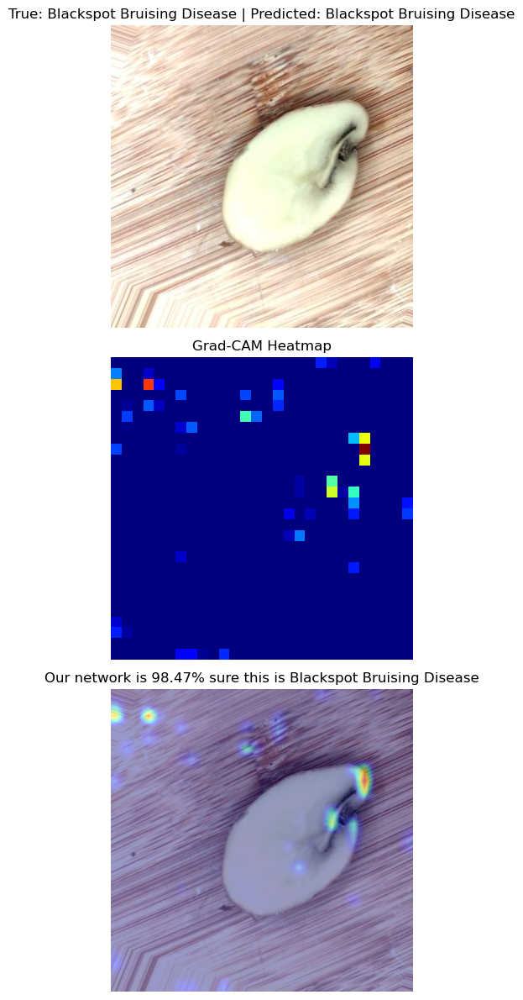

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


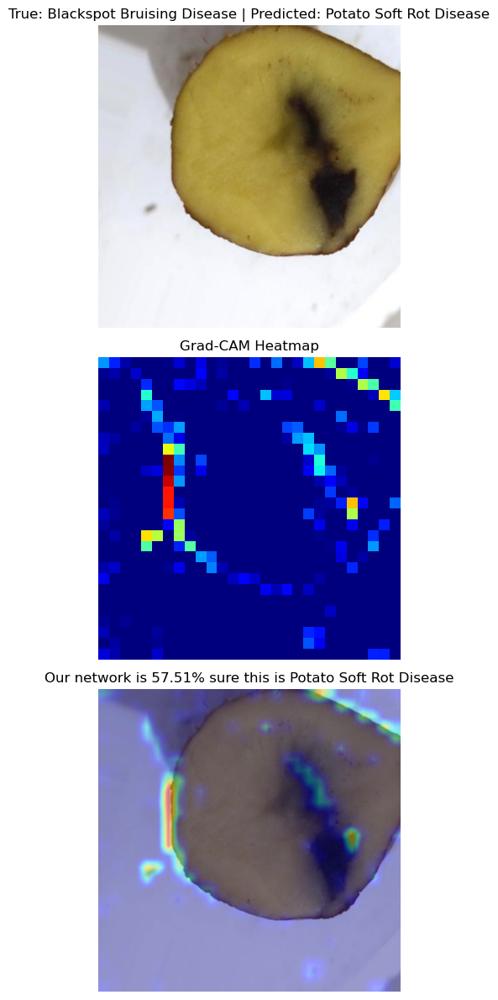

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


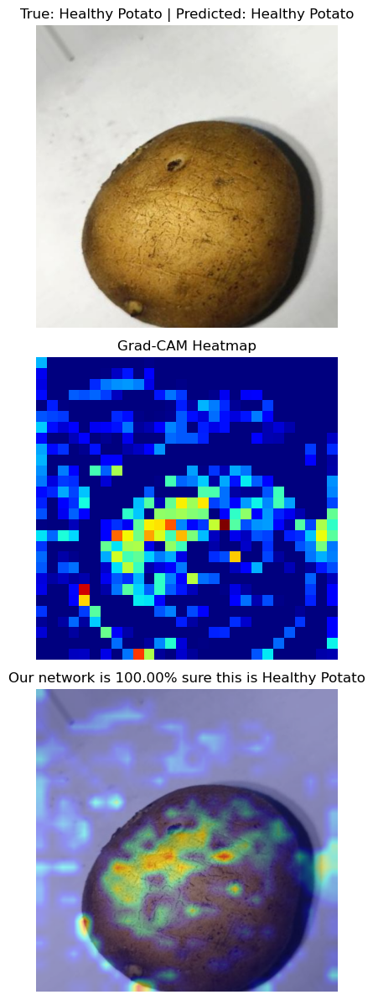

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


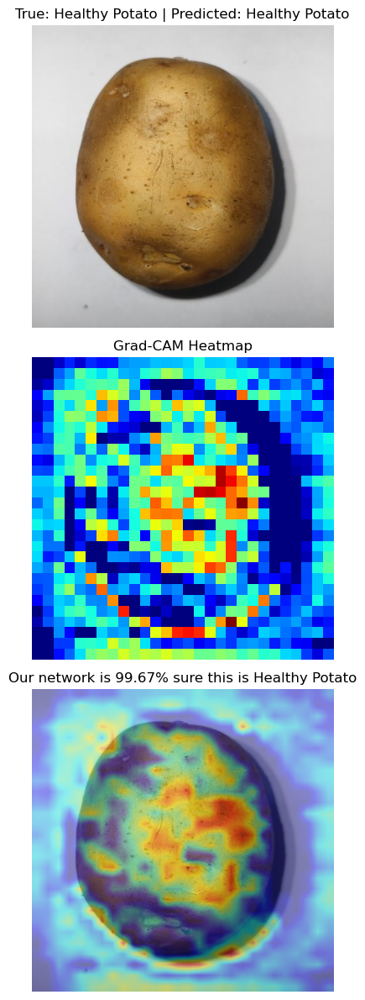

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


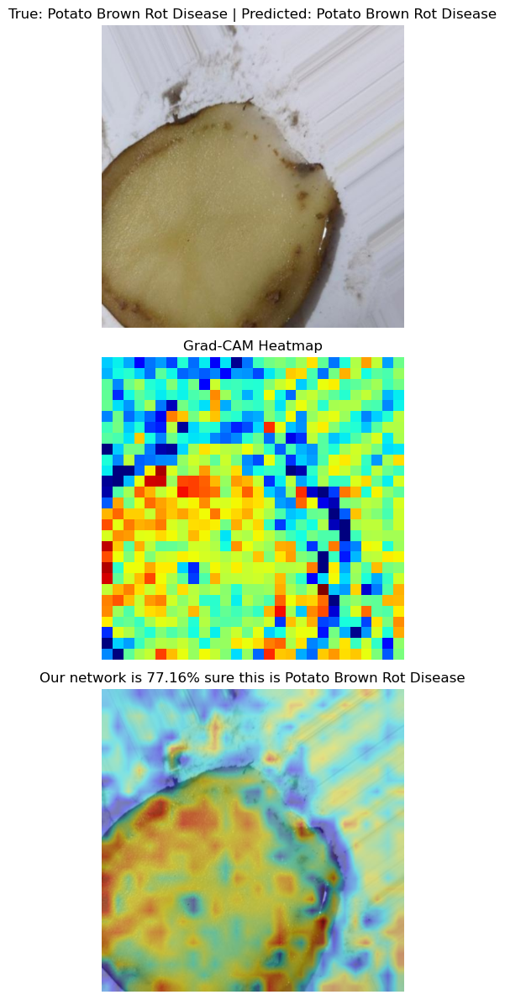

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


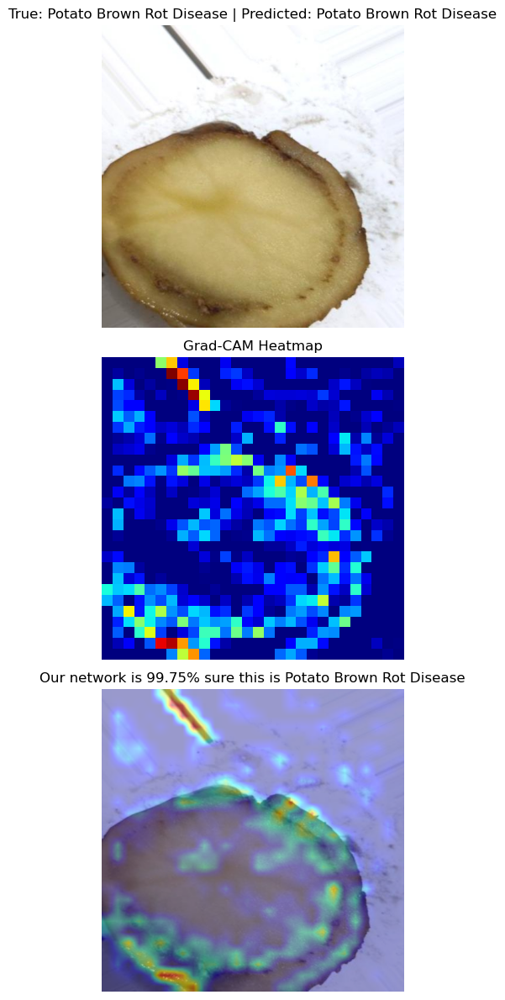

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


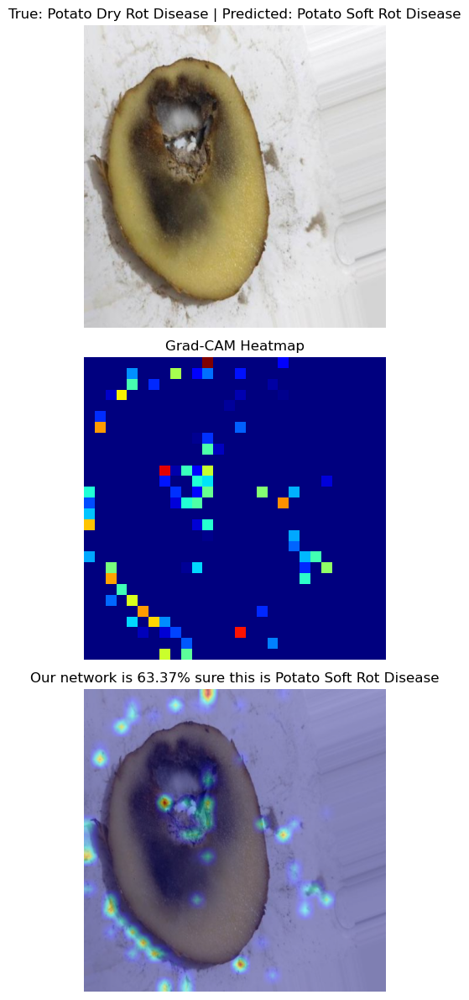

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step


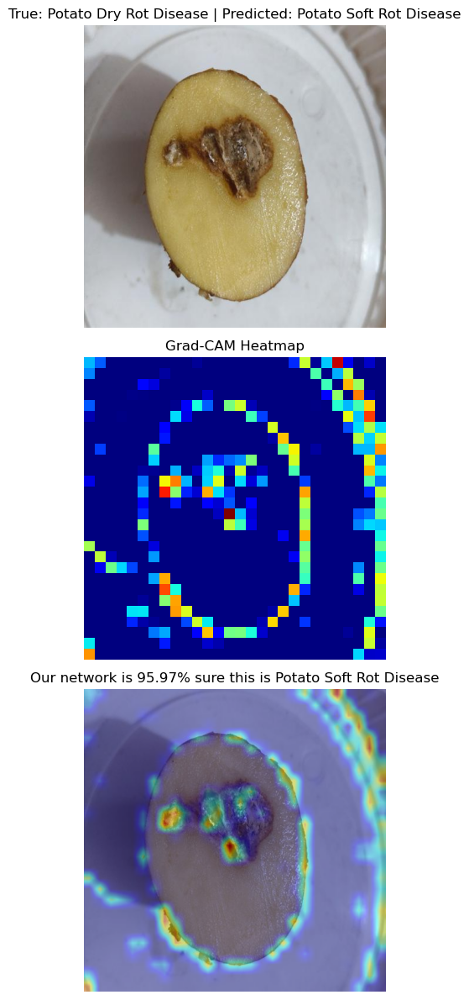

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step


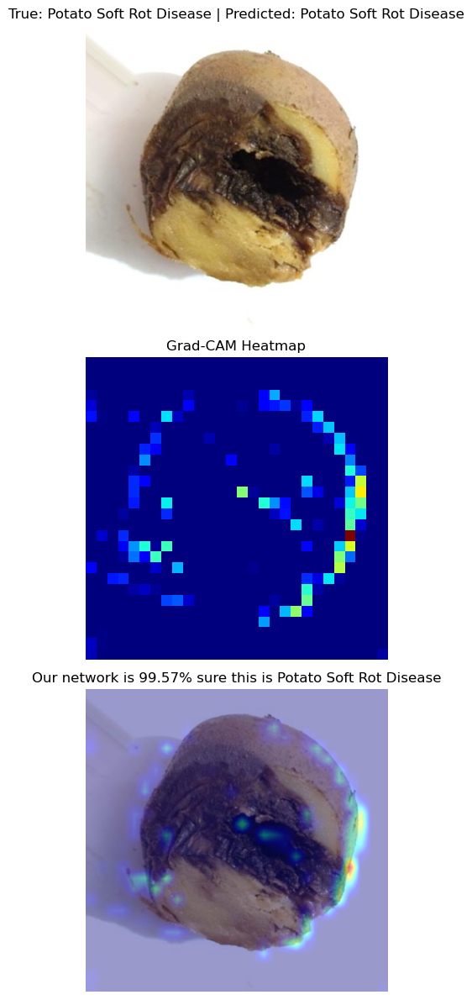

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step


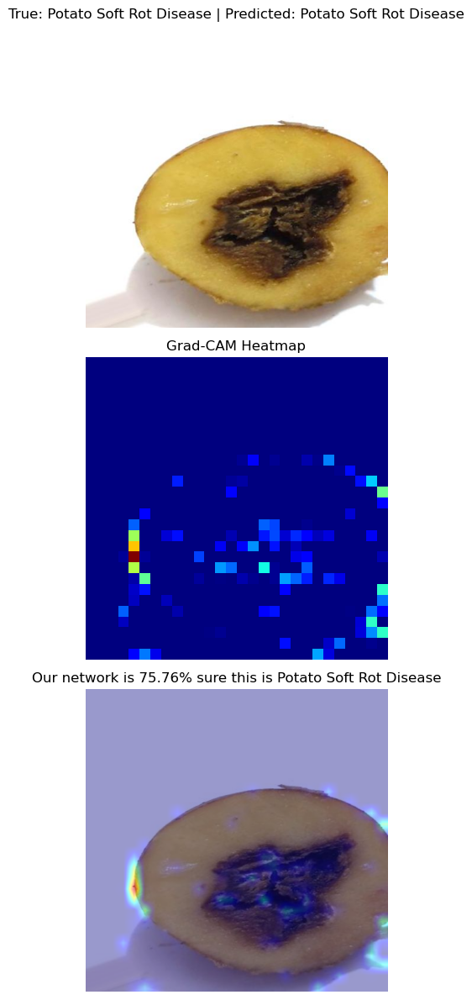

In [ ]:
import cv2
import random
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model
from tensorflow.keras import backend as K
from pathlib import Path
import tensorflow as tf
from tensorflow.keras.preprocessing import image
from keras.applications.nasnet import preprocess_input

# Define Grad-CAM functions
def generate_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    """
    Generate Grad-CAM heatmap for a given image and model.
    """
    # Create a model that maps the input image to the activations of the last conv layer and the predictions
    grad_model = Model([model.inputs], [model.get_layer(last_conv_layer_name).output, model.output])

    with tf.GradientTape() as tape:
        # Forward pass
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = np.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    # Compute gradients of the class output value with respect to the feature map
    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # Reshape pooled_grads to match the shape of conv_outputs
    pooled_grads = tf.reshape(pooled_grads, (1, 1, 1, -1))  # Reshape to (1, 1, 1, 44)

    # Compute the weighted sum of feature maps
    heatmap = tf.reduce_sum(conv_outputs * pooled_grads, axis=-1)

    # Normalize heatmap between 0 and 1
    heatmap = tf.maximum(heatmap, 0) / tf.reduce_max(heatmap + 1e-10)

    # Squeeze the extra dimensions to make it 2D (height x width)
    heatmap = np.squeeze(heatmap)  # Remove dimensions of size 1
    return heatmap

def superimpose_gradcam(img_path, heatmap, intensity=0.4):
    """
    Overlay the Grad-CAM heatmap on the original image.
    """
    img = cv2.imread(img_path)

    # Resize heatmap to match the original image dimensions
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))

    # Convert heatmap to a format suitable for colormap (0-255 and uint8)
    heatmap = np.uint8(255 * heatmap)  # Convert to 8-bit (0-255)

    # Apply color map
    heatmap = cv2.applyColorMap(heatmap, cv2.COLORMAP_JET)

    # Superimpose the heatmap on the original image
    superimposed_img = cv2.addWeighted(heatmap, intensity, img, 1 - intensity, 0)
    return cv2.cvtColor(superimposed_img, cv2.COLOR_BGR2RGB)

# Define classes for visualization
class_labels = ['Blackspot Bruising Disease', 'Healthy Potato', 'Potato Brown Rot Disease',
                'Potato Dry Rot Disease', 'Potato Soft Rot Disease']
last_conv_layer_name = 'normal_conv_1_1'  # NASNetMobile's last convolutional layer

# Randomly select 2 images per class for visualization
random_images = []
for class_index, class_name in enumerate(class_labels):
    class_dir = Path(f"A:/tuberSplit/test/{class_name}")
    all_images = list(class_dir.glob('*.*'))  # Adjust file extensions as needed
    selected_images = random.sample(all_images, 2)
    random_images.extend([(str(img_path), class_index) for img_path in selected_images])

# Preprocess the image (for NASNetMobile)
def proc_img(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = preprocess_input(img_array)  # NASNetMobile specific preprocessing
    return img_array

# Create a new figure for each image
for i, (img_path, true_label) in enumerate(random_images):
    # Preprocess the image
    img_array = proc_img(img_path)

    # Generate Grad-CAM heatmap
    heatmap = generate_gradcam_heatmap(img_array, model, last_conv_layer_name)

    # Superimpose heatmap on the original image
    gradcam_img = superimpose_gradcam(img_path, heatmap)

    # Display images in separate figures
    fig, axes = plt.subplots(3, 1, figsize=(8, 12))

    # Original image
    axes[0].imshow(cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB))
    axes[0].set_title(f"True: {class_labels[true_label]} | Predicted: {class_labels[np.argmax(model.predict(img_array))]}")
    axes[0].axis('off')

    # Heatmap (mask)
    axes[1].imshow(heatmap, cmap='jet')
    axes[1].set_title("Grad-CAM Heatmap")
    axes[1].axis('off')

    # Grad-CAM superimposed image
    axes[2].imshow(gradcam_img)
    confidence = np.max(model.predict(img_array)) * 100
    predicted_label = class_labels[np.argmax(model.predict(img_array))]
    axes[2].set_title(f"Our network is {confidence:.2f}% sure this is {predicted_label}")
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()


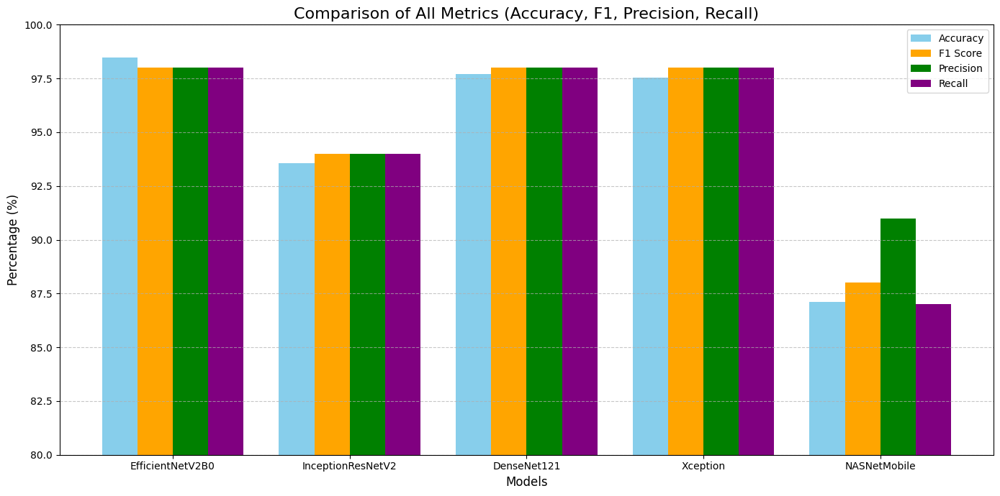

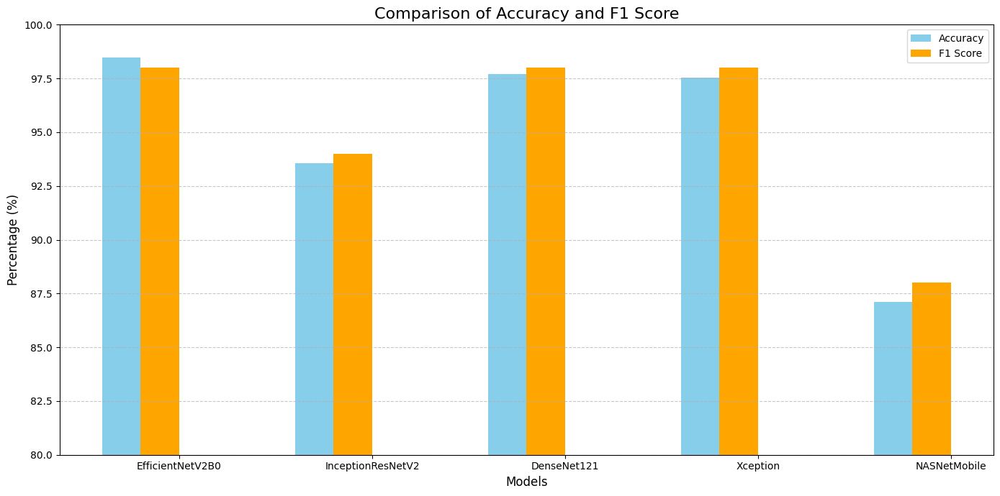

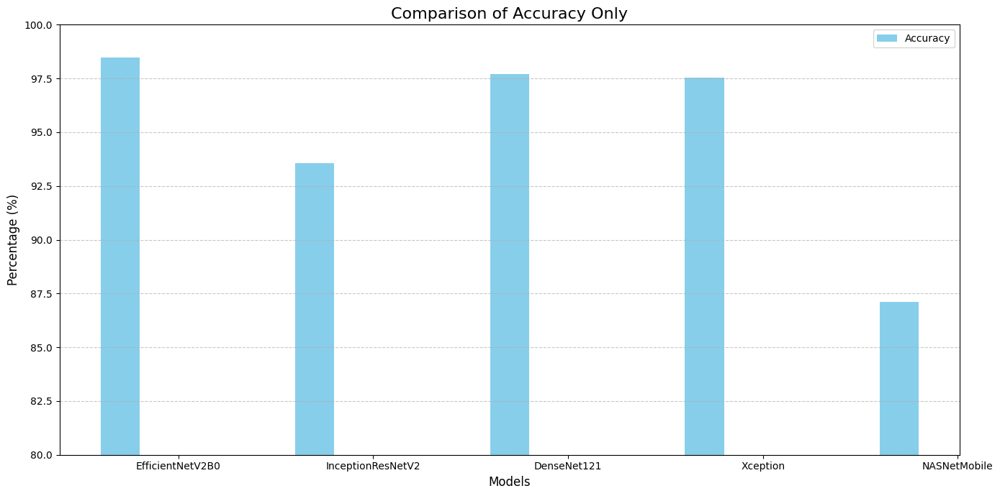

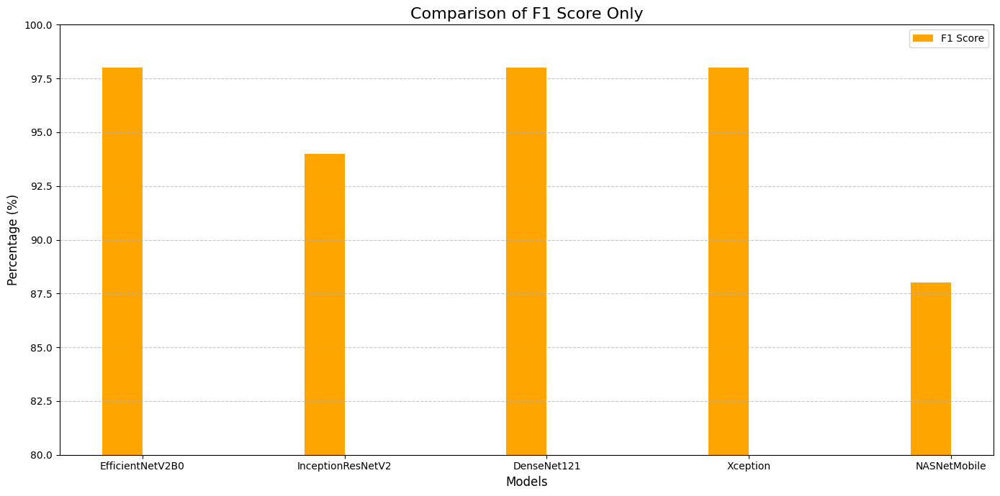

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Model names and metrics
models = [
    "EfficientNetV2B0",
    "InceptionResNetV2",
    "DenseNet121",
    "Xception",
    "NASNetMobile"
]

# Metrics
accuracies = [98.48, 93.55, 97.72, 97.53, 87.10]
f1_scores = [98.0, 94.0, 98.0, 98.0, 88.0]  # Scaled to percentages for consistency
precisions = [98.0, 94.0, 98.0, 98.0, 91.0]
recalls = [98.0, 94.0, 98.0, 98.0, 87.0]

# Bar settings
x = np.arange(len(models))
bar_width = 0.2


def plot_metrics(plot_title, include_accuracy=True, include_f1=True, include_precision=True, include_recall=True):
    """Plots the bar chart with the specified metrics."""
    plt.figure(figsize=(14, 7))

    # Bar position adjustments
    if include_accuracy:
        plt.bar(x - 1.5 * bar_width, accuracies, width=bar_width, label="Accuracy", color='skyblue')
    if include_f1:
        plt.bar(x - 0.5 * bar_width, f1_scores, width=bar_width, label="F1 Score", color='orange')
    if include_precision:
        plt.bar(x + 0.5 * bar_width, precisions, width=bar_width, label="Precision", color='green')
    if include_recall:
        plt.bar(x + 1.5 * bar_width, recalls, width=bar_width, label="Recall", color='purple')

    # Customize the plot
    plt.xlabel("Models", fontsize=12)
    plt.ylabel("Percentage (%)", fontsize=12)
    plt.title(plot_title, fontsize=16)
    plt.xticks(x, models, fontsize=10)
    plt.ylim(80, 100)
    plt.legend(fontsize=10)
    plt.grid(axis='y', linestyle='--', alpha=0.7)

    # Show the plot
    plt.tight_layout()
    plt.show()


# Generate the 5 requested plots
plot_metrics("Comparison of All Metrics (Accuracy, F1, Precision, Recall)",
             include_accuracy=True, include_f1=True, include_precision=True, include_recall=True)

plot_metrics("Comparison of Accuracy and F1 Score",
             include_accuracy=True, include_f1=True, include_precision=False, include_recall=False)

plot_metrics("Comparison of Accuracy Only",
             include_accuracy=True, include_f1=False, include_precision=False, include_recall=False)

plot_metrics("Comparison of F1 Score Only",
             include_accuracy=False, include_f1=True, include_precision=False, include_recall=False)
